# Loading Lake Track Visualization

In [1]:
import numpy as np
import pandas as pd
from ast import literal_eval

in_file = 'sample_data.csv'
sample = pd.read_csv(in_file, sep=';')
sample.ptsx = sample.ptsx.apply(literal_eval)
sample.ptsy = sample.ptsy.apply(literal_eval)

sample.head()

,image,speed,steering_angle,x,y,psi,ptsx,ptsy
0,sample_data/1.jpg,0.000000,-0.046513,-40.62000,108.7300,3.733651,"[-32.16173, -43.49173, -61.09, -78.29172, -93....","[113.361, 105.941, 92.88499, 78.73102, 65.3410..."
1,sample_data/2.jpg,0.965223,-0.015245,-40.62001,108.7301,3.733665,"[-32.16173, -43.49173, -61.09, -78.29172, -93....","[113.361, 105.941, 92.88499, 78.73102, 65.3410..."
2,sample_data/3.jpg,0.646475,-0.029914,-40.63263,108.7215,3.733861,"[-32.16173, -43.49173, -61.09, -78.29172, -93....","[113.361, 105.941, 92.88499, 78.73102, 65.3410..."
3,sample_data/4.jpg,1.210960,-0.077072,-40.66177,108.7017,3.734566,"[-32.16173, -43.49173, -61.09, -78.29172, -93....","[113.361, 105.941, 92.88499, 78.73102, 65.3410..."
4,sample_data/5.jpg,1.906278,-0.129254,-40.72135,108.6606,3.734843,"[-32.16173, -43.49173, -61.09, -78.29172, -93....","[113.361, 105.941, 92.88499, 78.73102, 65.3410..."


In [2]:
sample.describe()

,speed,steering_angle,x,y,psi
count,945.000000,945.000000,945.000000,945.000000,945.000000
mean,29.864284,-0.036600,8.913469,-6.084267,2.738646
std,3.789990,0.093276,112.558080,112.210391,1.844468
min,0.000000,-0.442037,-176.541400,-159.280400,0.000694
25%,29.999140,-0.081519,-93.022510,-129.026500,0.830496
50%,30.018270,-0.030914,24.316690,1.976867,3.028559
75%,30.050670,0.006358,108.665400,103.491900,3.993192
max,36.455230,0.379061,178.724700,158.430800,6.283102


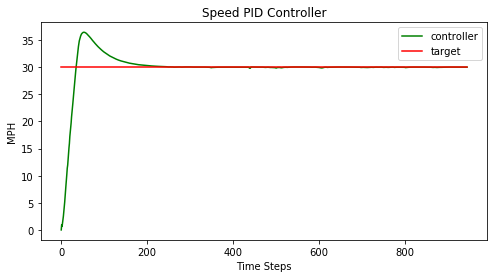

In [3]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
%matplotlib inline
speed = pd.Series(sample.speed)
fig, (ax1) = plt.subplots(1, 1, figsize=(8, 4))
p0 = ax1.plot(speed.index, speed, 'g', label='P controller')
p1 = ax1.plot(speed.index, np.ones(speed.count())*30.0, 'r', label='target')
ax1.set_xlabel("Time Steps", fontsize=10)
ax1.set_ylabel("MPH", fontsize=10)
plt.title('Speed PID Controller')
plt.legend((p0[0], p1[0]), ('controller', 'target'))
plt.show()

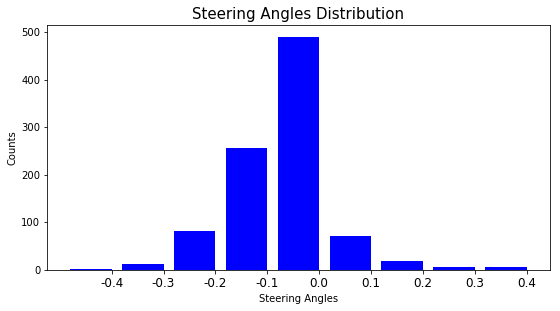

In [4]:
steering = pd.Series(sample.steering_angle)
steering = steering.round(1)

steerInfo = {}
for i in range(len(steering)):
    # get the current steering angle bucket
    if steering[i] == 0.:
        steer = '0.0'
    else:
        steer = str(steering[i])
    # try to see if there is a hash hit
    steerInstance = steerInfo.get(steer, {'count':0, 'samples':[]})
    # add to count
    count = steerInstance['count'] + 1
    # add to samples
    samples = steerInstance['samples']
    samples.append(i)
    # put in the last index
    steerInfo[steer] = {'lastIdx':i, 'count': count, 'steering_angle':steering[i], 'samples':samples}
    
# get the list of steer and sort them
sortedSteering = list(steerInfo.keys())
def compare_steer(steer):
    return steerInfo[steer]['steering_angle']
sortedSteering.sort(key=compare_steer)
steerCounts = [steerInfo[n]['count'] for n in sortedSteering]

n_steers = len(sortedSteering)

ind = np.arange(n_steers)
width = 0.8

fg, ax = plt.subplots(figsize=(n_steers, n_steers/2))
rects1 = ax.bar(ind+1.6, steerCounts, width, color='b')

# add some text for labels, title and axes ticks
ax.set_ylabel("Counts", fontsize=10)
ax.set_title("Steering Angles Distribution", fontsize=15)
ax.set_xticks(ind + width + 1.2)
ax.set_xticklabels(sortedSteering, fontsize=12)
ax.set_xlabel("Steering Angles", fontsize=10)
plt.show()


Steering Angle Image Samples: 100%|██████████| 9/9 [00:03<00:00,  2.56angles/s]


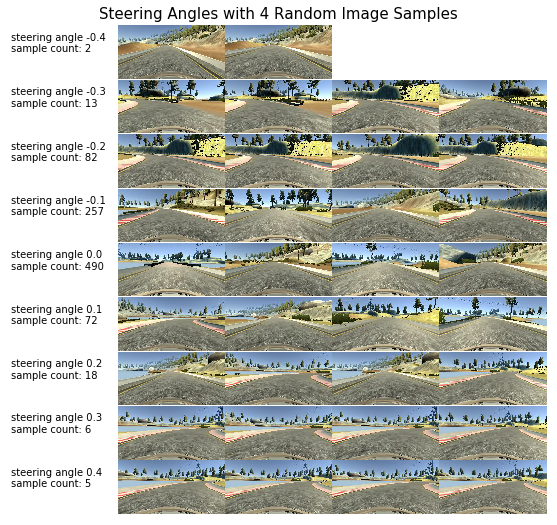

In [5]:
from tqdm import tqdm
import random

n_samples = 4

# size of each sample
fig, ax0 = plt.subplots(figsize=(n_samples*2.4, n_steers))
ax0.set_title("Steering Angles with 4 Random Image Samples", fontsize=15)
ax0.set_xticks([])
ax0.set_yticks([])
w_ratios = [1 for n in range(n_samples)]
w_ratios[:0] = [int(n_samples*0.4)]
h_ratios = [1 for n in range(n_steers)]

# gridspec
grid = gridspec.GridSpec(n_steers, n_samples+1, wspace=0.0, hspace=0.0, width_ratios=w_ratios, height_ratios=h_ratios)
steerset_pbar = tqdm(range(n_steers), desc='Steering Angle Image Samples', unit='angles')
for a in steerset_pbar:
    steer = str(sortedSteering[a])
    count = steerInfo[steer]['count']
    for b in range(n_samples+1):
        i = a*(n_samples+1) + b
        ax = plt.Subplot(fig, grid[i])
        if b == 0:
            ax.annotate('steering angle %s\nsample count: %d'%(steer, count), xy=(0,0), xytext=(0.0,0.5))
            ax.set_xticks([])
            ax.set_yticks([])
            fig.add_subplot(ax)
        elif count < n_samples:
            if (b-1) < count:
                image=mpimg.imread(sample.image[b-1])
                ax.imshow(image)
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
            else:
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
        else:
            random_i = random.choice(steerInfo[steer]['samples'])
            image=mpimg.imread(sample.image[random_i])
            ax.imshow(image)
            ax.set_xticks([])
            ax.set_yticks([])
            fig.add_subplot(ax)
    
    # hide the borders\
    if a == (n_steers-1):
        all_axes = fig.get_axes()
        for ax in all_axes:
            for sp in ax.spines.values():
                sp.set_visible(False)
                
for sp in ax0.spines.values():
    sp.set_visible(False)

plt.show()

In [6]:
waypoint_file = "lake_track_waypoints.csv"
ml_waypoint_file = "lake_track_ml_generated_waypoints.csv"

with open(waypoint_file) as f:
    x_waypoint = []
    y_waypoint = []
    count = 0
    for line in f:
        if count > 0:
            data = line.split(',')
            x_waypoint.append(data[0])
            y_waypoint.append(data[1])
        count += 1
    
with open(ml_waypoint_file) as f:
    x_ml_waypoint = []
    y_ml_waypoint = []
    count = 0
    for line in f:
        if count > 0:
            data = line.split(',')
            x_ml_waypoint.append(data[0])
            y_ml_waypoint.append(data[1])   
        count += 1
        
x_start = [ x_ml_waypoint[0] ]
y_start = [ y_ml_waypoint[1] ]


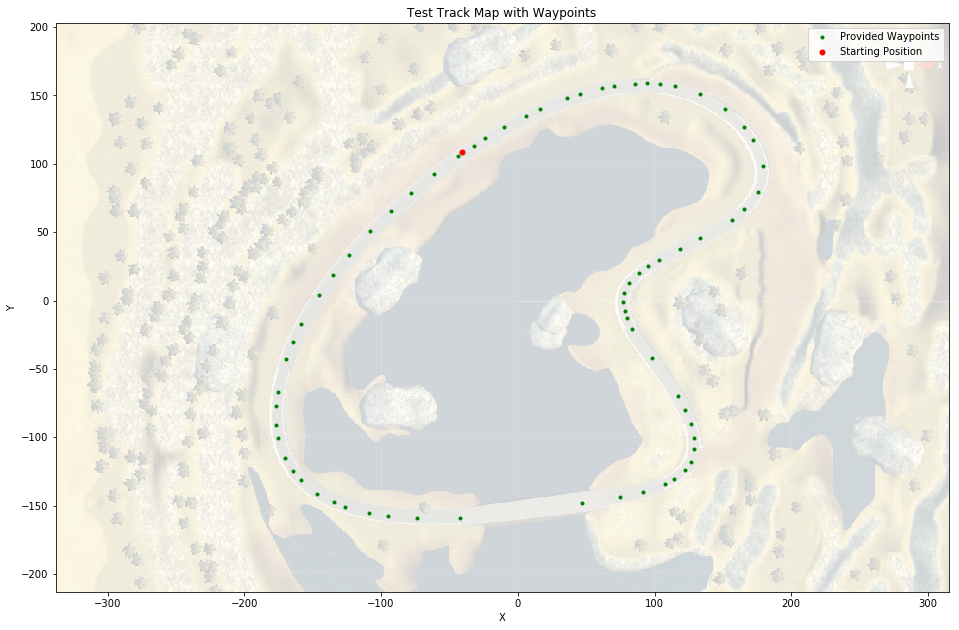

In [7]:
plt.rcParams["figure.figsize"] = [16, 16]
img=mpimg.imread('track1_top_view.png')
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p2 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p3 = plt.plot(x_start, y_start, 'ro', ms=5.0)
plt.title('Test Track Map with Waypoints')
plt.xlabel("X", fontsize=10)
plt.ylabel("Y", fontsize=10)
plt.legend((p2[0], p3[0]), ('Provided Waypoints', 'Starting Position'))
plt.show()

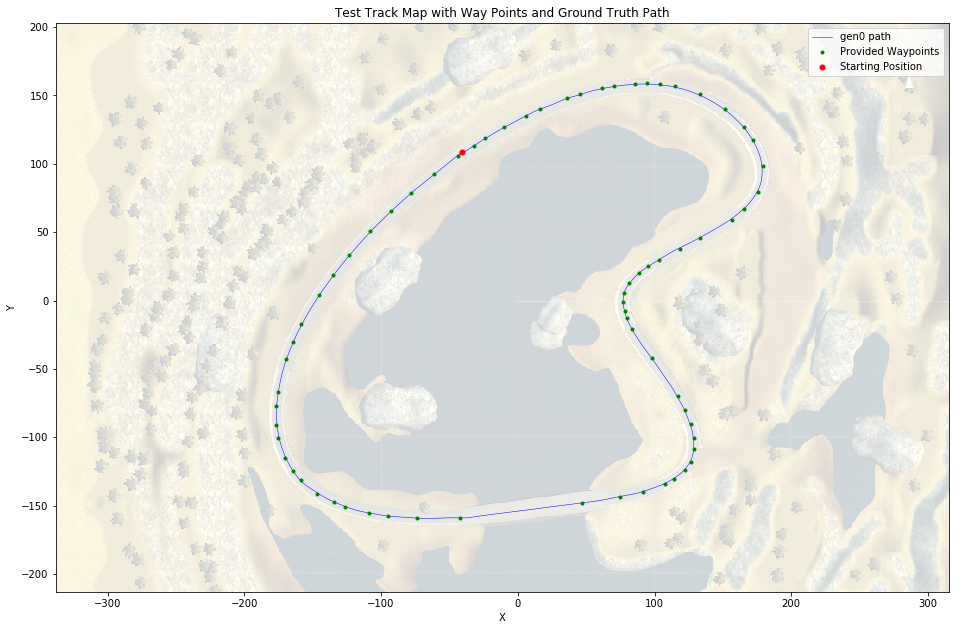

In [8]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_ml_waypoint, y_ml_waypoint, 'b', lw=0.5)
p2 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p3 = plt.plot(x_start, y_start, 'ro', ms=5.0)
plt.title('Test Track Map with Way Points and Ground Truth Path')
plt.xlabel("X", fontsize=10)
plt.ylabel("Y", fontsize=10)
plt.legend((p1[0], p2[0], p3[0]), ('gen0 path', 'Provided Waypoints', 'Starting Position'))
plt.show()

In [9]:
data = pd.read_csv('../gen1/training-progress.csv')
generation = 'g=1'

In [10]:
# create subsets
training_data = data[data['testing'] == False]
testing_data = data[data['testing'] == True]
testing_sessions = []
testing_sessions_end = []
for i in range(testing_data['session'].max()):
    testing_sessions.append(testing_data[testing_data['session'] == (i+1)])
    end_timestep = testing_sessions[i]['lap_timestep'].max()
    testing_sessions_end.append(testing_sessions[i][testing_sessions[i]['lap_timestep'] == end_timestep])
test_end = pd.concat(testing_sessions_end)
test_end

,session,testing,lap_timestep,training_sample,acte,mse,success,x,y
1508,1,True,320,250,113.595207,0.004482,False,-158.39010,-134.86050
2736,2,True,663,250,175.989280,0.002924,False,131.30830,-107.80860
4305,3,True,1276,250,601.879680,0.002579,True,-36.12216,110.68140
4877,4,True,321,250,85.339736,0.002963,False,-157.92200,-135.22170
6281,5,True,1199,227,417.908545,0.001162,True,-36.72024,110.33690
6994,6,True,563,188,169.688902,0.001063,False,67.21069,-142.98000
8295,7,True,1201,144,448.672057,0.001523,True,-36.04072,110.53600
9103,8,True,649,151,200.773333,0.002645,False,131.24310,-99.83900
10431,9,True,1198,140,489.304567,0.000938,True,-36.57455,110.31360
11346,10,True,804,125,247.715735,0.003108,False,92.01289,25.51036


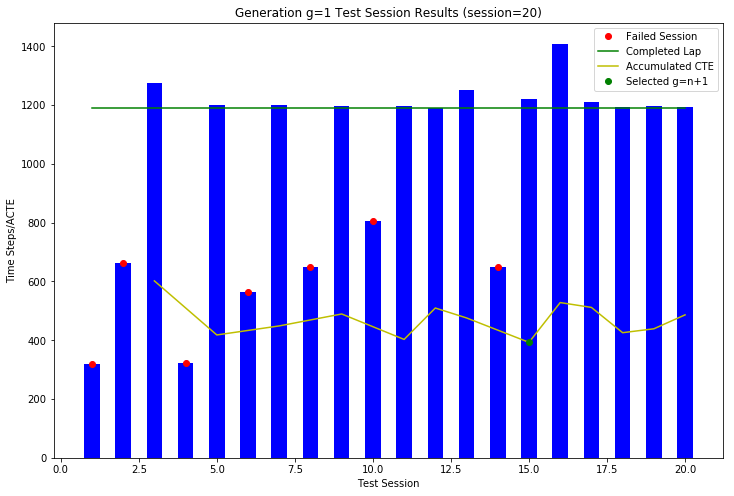

In [11]:
# create subsets
subsample = test_end[test_end['session'] < 21]
result_success = subsample[subsample['success'] == True]
result_failure = subsample[subsample['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = subsample['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, subsample['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(subsample['session'], np.ones(subsample['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=20)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

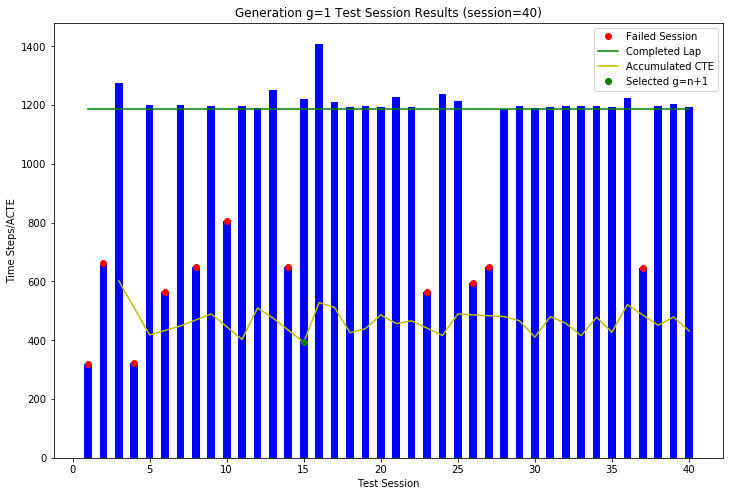

In [12]:
# create subsets
result_success = test_end[test_end['success'] == True]
result_failure = test_end[test_end['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = test_end['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(test_end['session'], np.ones(test_end['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=40)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

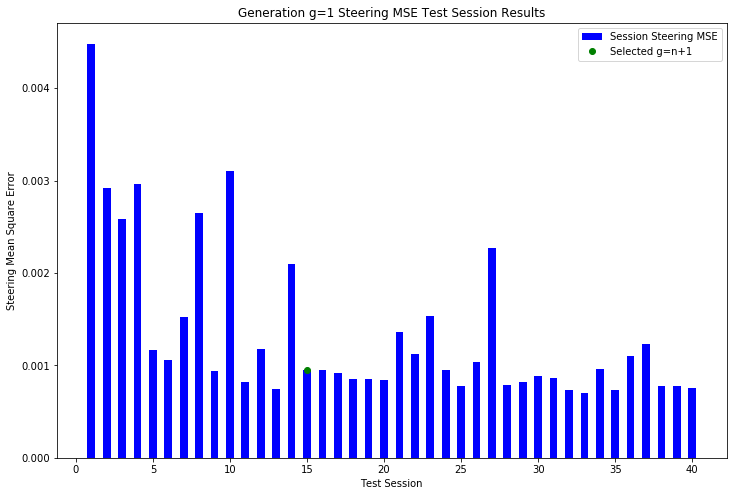

In [13]:
fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['mse'], width, color='b', label='Session Steering MSE')
p1 = ax1.plot(selected['session'], selected['mse'], 'go', label='Selected g=n+1')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Steering Mean Square Error", fontsize=10)
plt.title('Generation {} Steering MSE Test Session Results'.format(generation))
plt.legend((p0[0], p1[0]), ('Session Steering MSE', 'Selected g=n+1'))
plt.show()

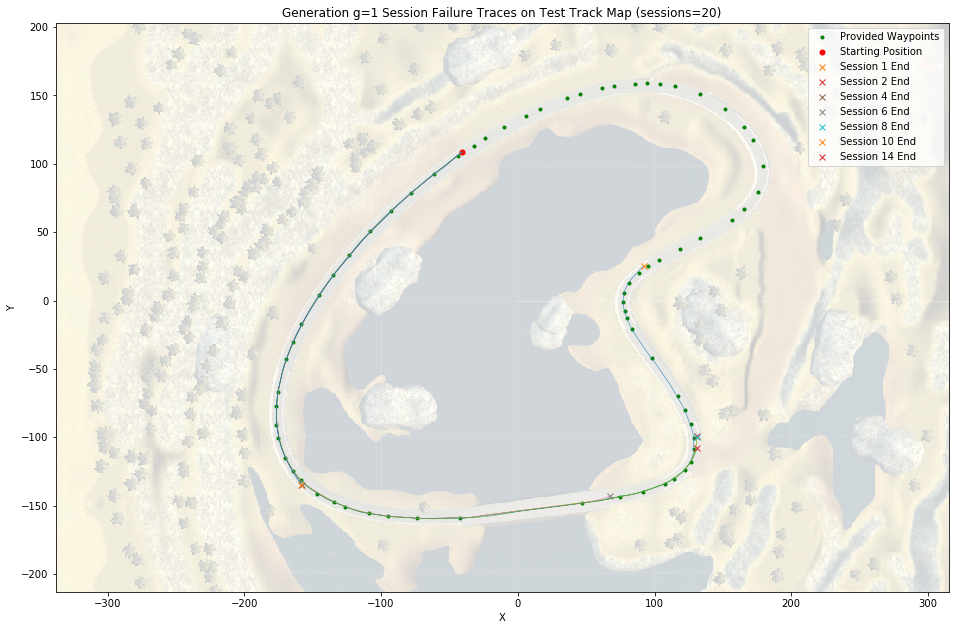

In [14]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (sessions=20)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    if j < 21:
        testing_sessions.append(testing_data[testing_data['session'] == j])
        testing_sessions_end.append(result_failure[result_failure['session'] == j])
        plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
        sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
        labels.append('Session {} End'.format(j))
        i += 1
plt.legend(sessions, labels)
plt.show()

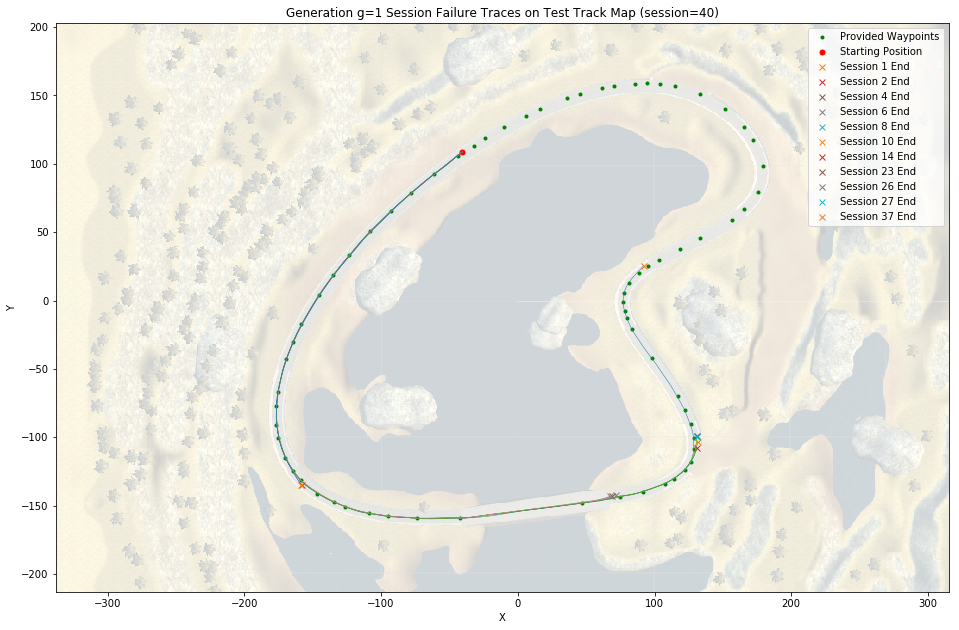

In [15]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_failure[result_failure['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()

In [16]:
result_success.describe()

,session,lap_timestep,training_sample,acte,mse,x,y
count,29.000000,29.000000,29.000000,29.000000,29.000000,29.000000,29.000000
mean,22.827586,1212.827586,116.448276,464.026916,0.000980,-36.438474,110.397862
std,10.869581,42.766032,37.748781,45.153241,0.000364,0.235430,0.158712
min,3.000000,1186.000000,78.000000,392.791092,0.000703,-36.889640,110.001400
25%,15.000000,1195.000000,97.000000,427.233160,0.000781,-36.582990,110.310400
50%,22.000000,1197.000000,109.000000,466.006687,0.000863,-36.467060,110.374800
75%,32.000000,1213.000000,116.000000,486.244266,0.000964,-36.246630,110.503400
max,40.000000,1409.000000,250.000000,601.879680,0.002579,-36.040720,110.681800


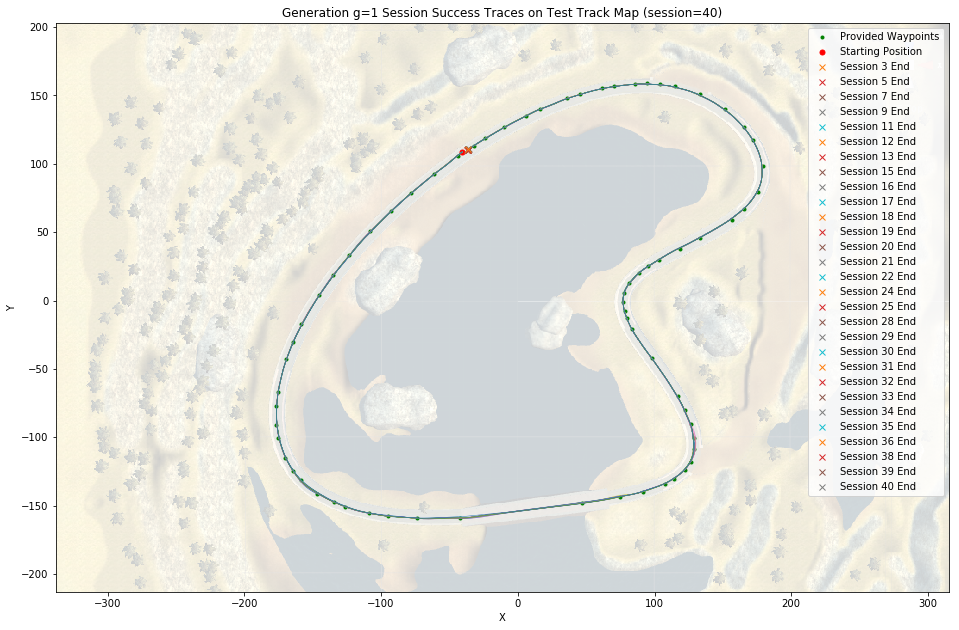

In [17]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Success Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_success['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_success[result_success['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()
all_result_success = result_success
all_testing_sessions = testing_sessions

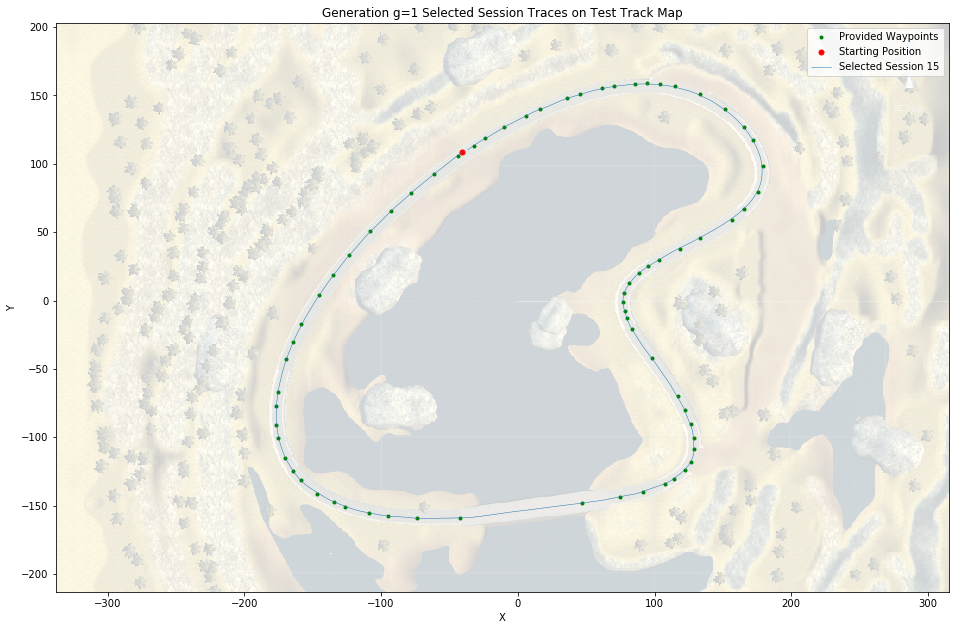

In [18]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Selected Session Traces on Test Track Map'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
j = int(selected['session'])
testing_sessions.append(testing_data[testing_data['session'] == j])
sessions.append(plt.plot(testing_sessions[0]['x'], testing_sessions[0]['y'], alpha=1.0, lw=0.5, zorder=40-i)[0])
labels.append('Selected Session {}'.format(j))
plt.legend(sessions, labels)
plt.show()

In [19]:
data = pd.read_csv('../gen2/training-progress.csv')
generation = 'g=2'

In [20]:
# create subsets
training_data = data[data['testing'] == False]
testing_data = data[data['testing'] == True]
testing_sessions = []
testing_sessions_end = []
for i in range(testing_data['session'].max()):
    testing_sessions.append(testing_data[testing_data['session'] == (i+1)])
    end_timestep = testing_sessions[i]['lap_timestep'].max()
    testing_sessions_end.append(testing_sessions[i][testing_sessions[i]['lap_timestep'] == end_timestep])
test_end = pd.concat(testing_sessions_end)
test_end

,session,testing,lap_timestep,training_sample,acte,mse,success,x,y
1323,1,True,122,250,71.996644,0.012277,False,-119.130800,35.01854
2161,2,True,111,250,63.110386,0.015026,False,-109.421000,45.79911
3226,3,True,448,250,318.116942,0.016364,False,-42.924880,-157.08400
4263,4,True,447,250,112.466905,0.004103,False,-42.516190,-157.19450
5144,5,True,449,250,160.432256,0.005564,False,-41.653180,-157.08930
5989,6,True,449,250,103.103401,0.003120,False,-42.222070,-157.14460
6794,7,True,450,250,206.465374,0.009278,False,-39.170560,-156.78910
7658,8,True,460,250,113.725341,0.002678,False,-31.321780,-155.95000
8423,9,True,452,250,149.937518,0.004026,False,-38.869450,-156.69310
9213,10,True,456,250,122.286283,0.003433,False,-35.548040,-156.29540


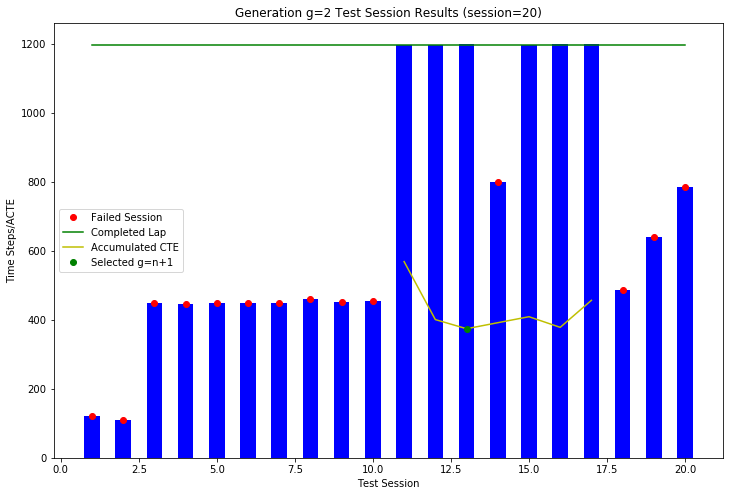

In [21]:
# create subsets
subsample = test_end[test_end['session'] < 21]
result_success = subsample[subsample['success'] == True]
result_failure = subsample[subsample['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = subsample['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, subsample['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(subsample['session'], np.ones(subsample['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=20)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

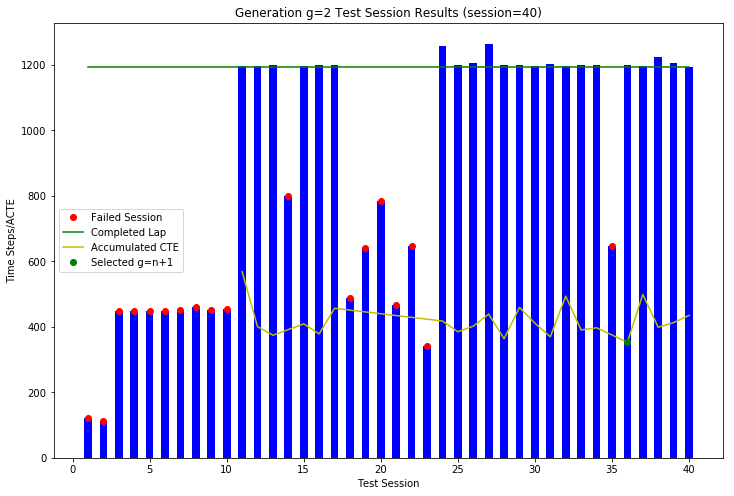

In [22]:
# create subsets
result_success = test_end[test_end['success'] == True]
result_failure = test_end[test_end['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = test_end['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(test_end['session'], np.ones(test_end['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=40)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

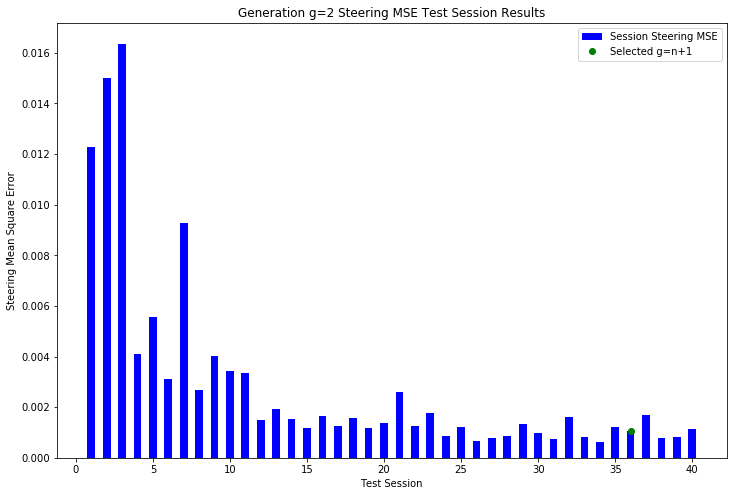

In [23]:
fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['mse'], width, color='b', label='Session Steering MSE')
p1 = ax1.plot(selected['session'], selected['mse'], 'go', label='Selected g=n+1')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Steering Mean Square Error", fontsize=10)
plt.title('Generation {} Steering MSE Test Session Results'.format(generation))
plt.legend((p0[0], p1[0]), ('Session Steering MSE', 'Selected g=n+1'))
plt.show()

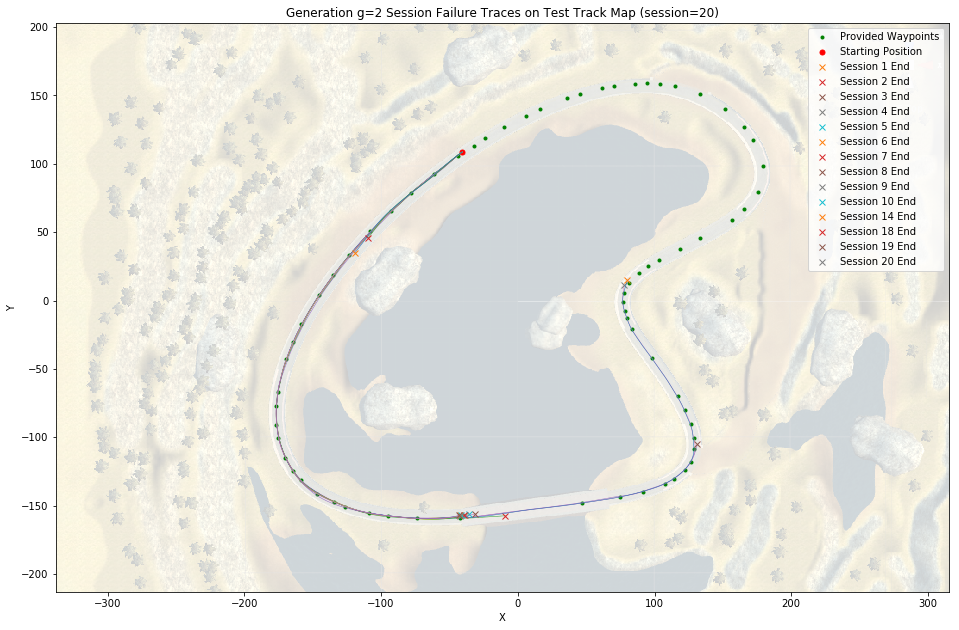

In [24]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=20)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    if j < 21:
        testing_sessions.append(testing_data[testing_data['session'] == j])
        testing_sessions_end.append(result_failure[result_failure['session'] == j])
        plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
        sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
        labels.append('Session {} End'.format(j))
        i += 1
plt.legend(sessions, labels)
plt.show()

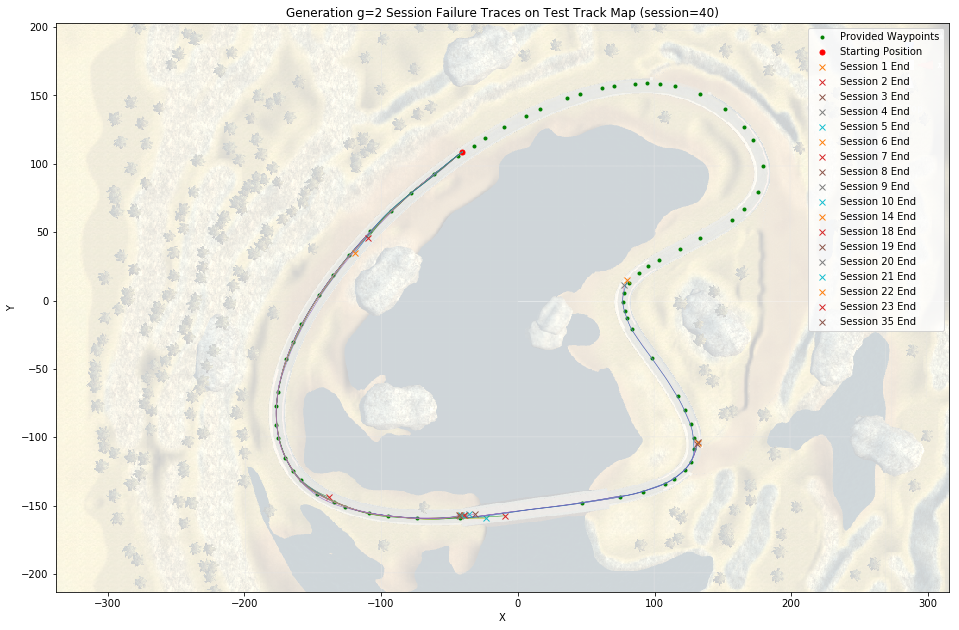

In [25]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_failure[result_failure['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()

In [26]:
result_success.describe()

,session,lap_timestep,training_sample,acte,mse,x,y
count,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000
mean,26.954545,1206.181818,156.136364,418.874242,0.001218,-36.496833,110.528850
std,9.286330,18.819029,48.823585,51.334744,0.000602,0.240300,0.162188
min,11.000000,1195.000000,93.000000,352.825882,0.000640,-36.821320,110.164000
25%,18.750000,1198.000000,116.000000,386.341129,0.000815,-36.696925,110.423525
50%,28.500000,1200.000000,143.000000,405.533882,0.001098,-36.543005,110.514100
75%,33.750000,1201.750000,196.250000,438.031692,0.001444,-36.305805,110.613625
max,40.000000,1265.000000,250.000000,568.952512,0.003353,-36.065580,110.794800


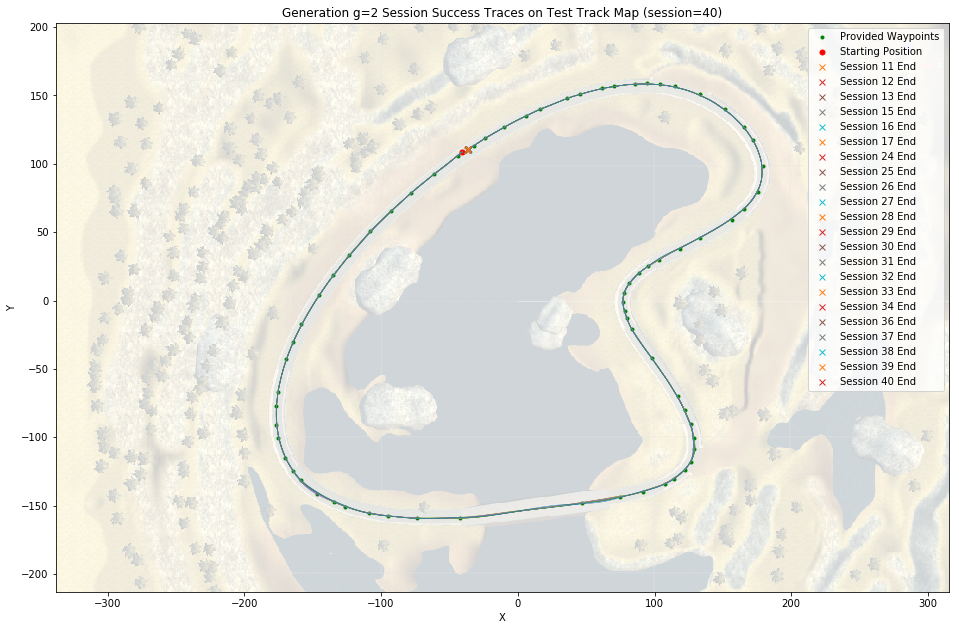

In [27]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Success Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_success['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_success[result_success['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()
all_result_success = pd.concat([all_result_success, result_success])
all_testing_sessions += testing_sessions

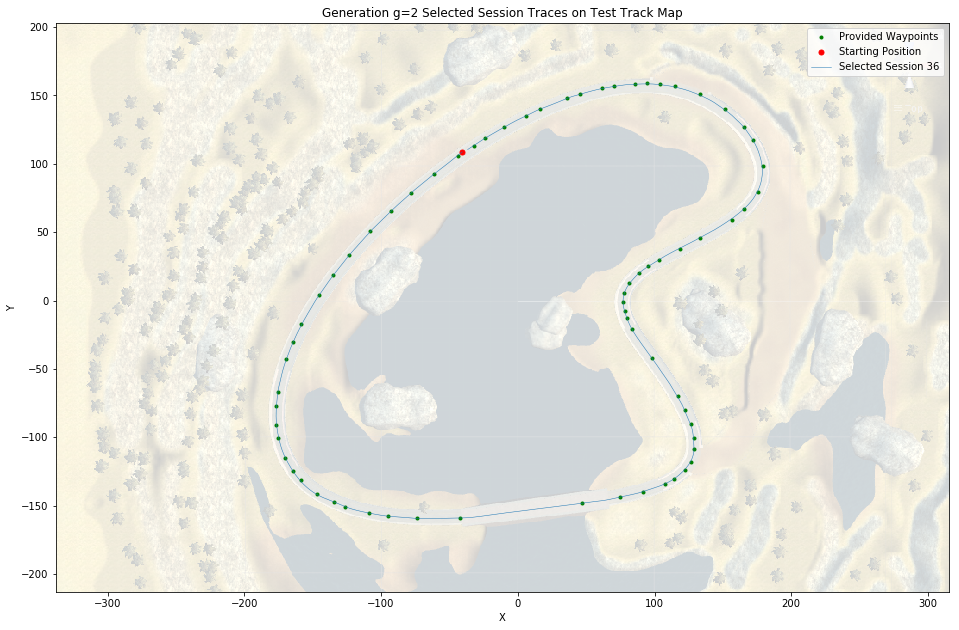

In [28]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Selected Session Traces on Test Track Map'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
j = int(selected['session'])
testing_sessions.append(testing_data[testing_data['session'] == j])
sessions.append(plt.plot(testing_sessions[0]['x'], testing_sessions[0]['y'], alpha=1.0, lw=0.5, zorder=40-i)[0])
labels.append('Selected Session {}'.format(j))
plt.legend(sessions, labels)
plt.show()

In [29]:
data = pd.read_csv('../gen3/training-progress.csv')
generation = 'g=3'

In [30]:
# create subsets
training_data = data[data['testing'] == False]
testing_data = data[data['testing'] == True]
testing_sessions = []
testing_sessions_end = []
for i in range(testing_data['session'].max()):
    testing_sessions.append(testing_data[testing_data['session'] == (i+1)])
    end_timestep = testing_sessions[i]['lap_timestep'].max()
    testing_sessions_end.append(testing_sessions[i][testing_sessions[i]['lap_timestep'] == end_timestep])
test_end = pd.concat(testing_sessions_end)
test_end

,session,testing,lap_timestep,training_sample,acte,mse,success,x,y
1314,1,True,122,250,68.038364,0.010300,False,-119.011500,35.04916
2144,2,True,119,250,74.709898,0.010881,False,-114.906700,39.82890
2859,3,True,154,250,87.909050,0.004191,False,-136.717700,12.69281
3581,4,True,372,250,166.516084,0.003666,False,-114.644000,-152.02980
4179,5,True,325,250,128.169508,0.004586,False,-154.357400,-138.37430
4795,6,True,328,250,76.986370,0.001432,False,-153.236600,-139.16850
6208,7,True,1201,231,395.837103,0.001183,True,-36.708040,110.46630
6752,8,True,467,154,154.463977,0.002159,False,-23.580390,-159.36970
7261,9,True,328,167,67.829774,0.001493,False,-151.993100,-140.04310
7988,10,True,529,182,179.967601,0.002113,False,34.344440,-147.69110


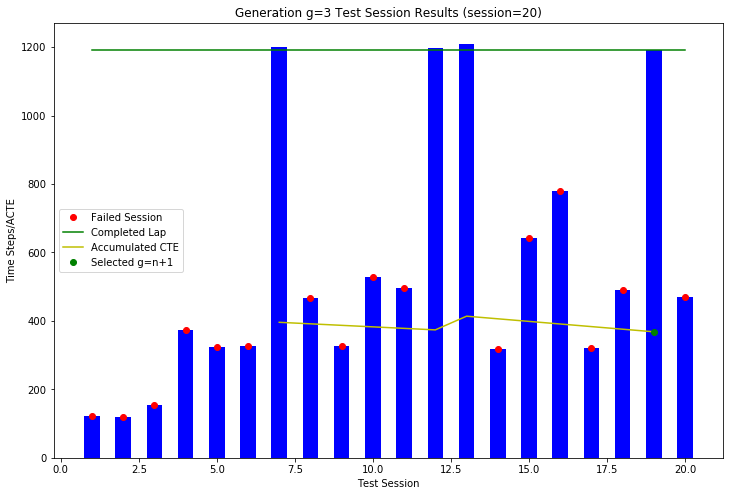

In [31]:
# create subsets
subsample = test_end[test_end['session'] < 21]
result_success = subsample[subsample['success'] == True]
result_failure = subsample[subsample['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = subsample['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, subsample['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(subsample['session'], np.ones(subsample['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=20)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

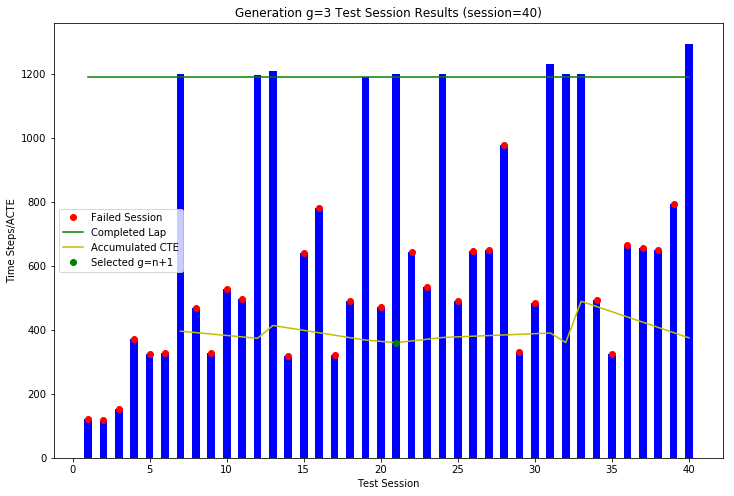

In [32]:
# create subsets
result_success = test_end[test_end['success'] == True]
result_failure = test_end[test_end['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = test_end['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(test_end['session'], np.ones(test_end['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=40)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

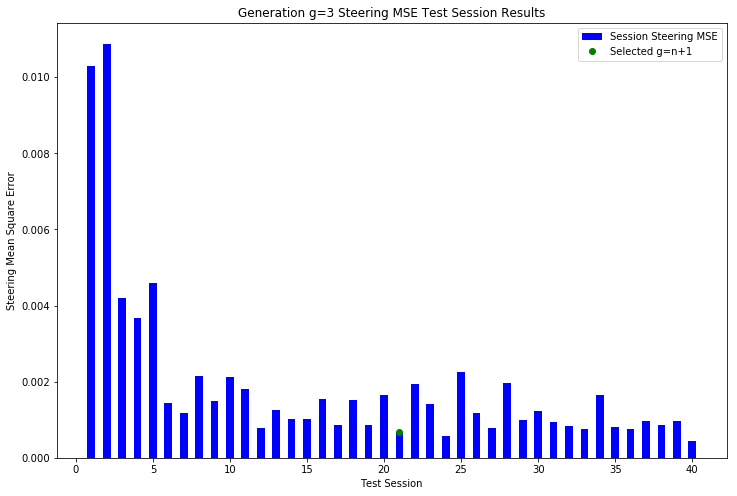

In [33]:
fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['mse'], width, color='b', label='Session Steering MSE')
p1 = ax1.plot(selected['session'], selected['mse'], 'go', label='Selected g=n+1')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Steering Mean Square Error", fontsize=10)
plt.title('Generation {} Steering MSE Test Session Results'.format(generation))
plt.legend((p0[0], p1[0]), ('Session Steering MSE', 'Selected g=n+1'))
plt.show()

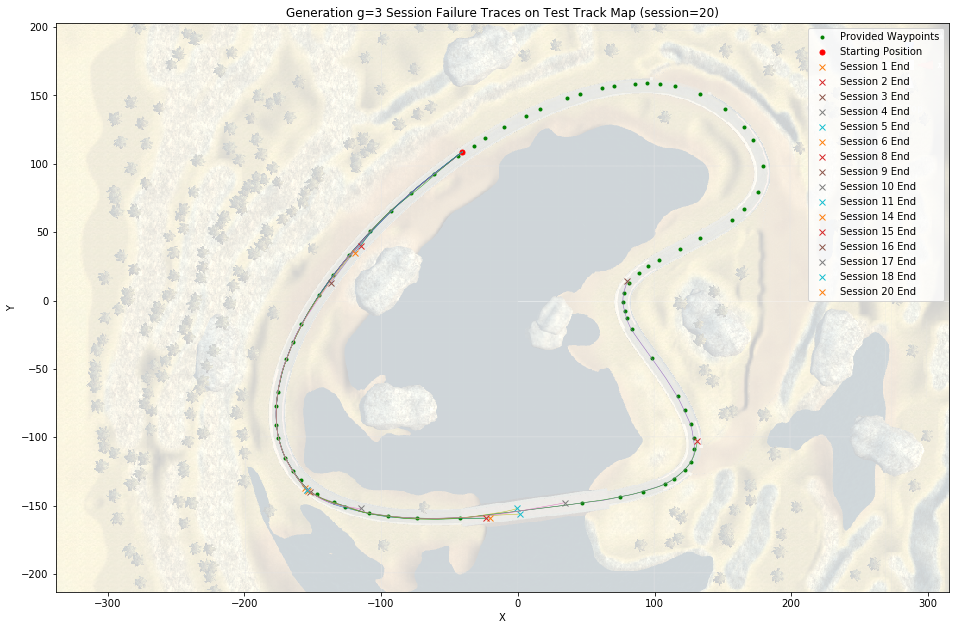

In [34]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=20)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    if j < 21:
        testing_sessions.append(testing_data[testing_data['session'] == j])
        testing_sessions_end.append(result_failure[result_failure['session'] == j])
        plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
        sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
        labels.append('Session {} End'.format(j))
        i += 1
plt.legend(sessions, labels)
plt.show()

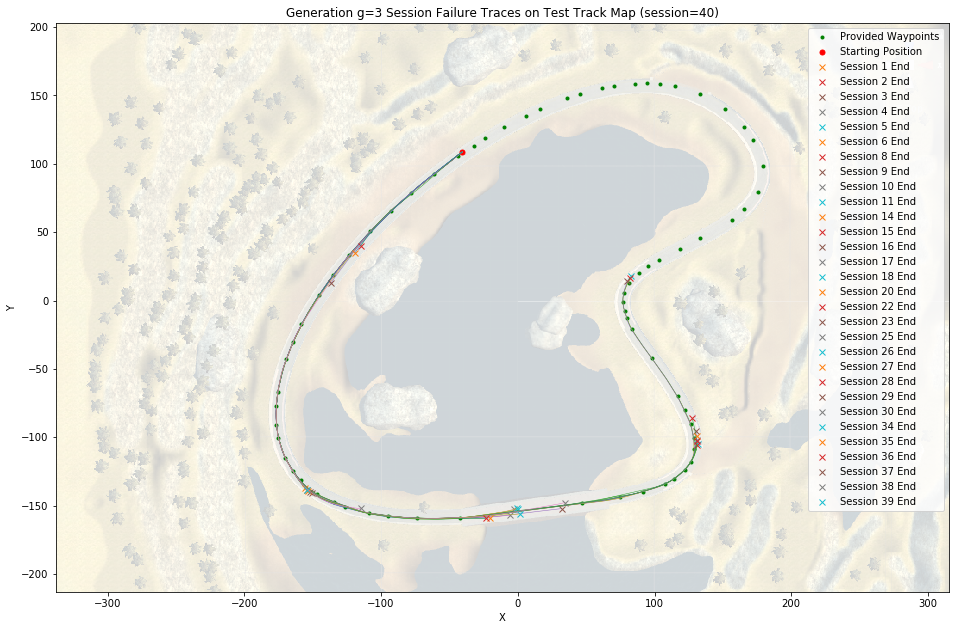

In [35]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_failure[result_failure['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()

In [36]:
result_success.describe()

,session,lap_timestep,training_sample,acte,mse,x,y
count,10.000000,10.000000,10.00000,10.000000,10.000000,10.000000,10.000000
mean,23.200000,1212.200000,119.50000,390.230705,0.000830,-36.561882,110.540880
std,10.706177,30.947267,44.63245,38.590904,0.000247,0.268129,0.172533
min,7.000000,1192.000000,89.00000,359.888926,0.000447,-37.022660,110.203700
25%,14.500000,1199.000000,94.25000,369.508370,0.000705,-36.760757,110.451600
50%,22.500000,1200.000000,99.50000,375.580870,0.000810,-36.542330,110.545350
75%,31.750000,1207.750000,119.75000,394.415822,0.000914,-36.337853,110.678250
max,40.000000,1295.000000,231.00000,489.324251,0.001243,-36.203300,110.755300


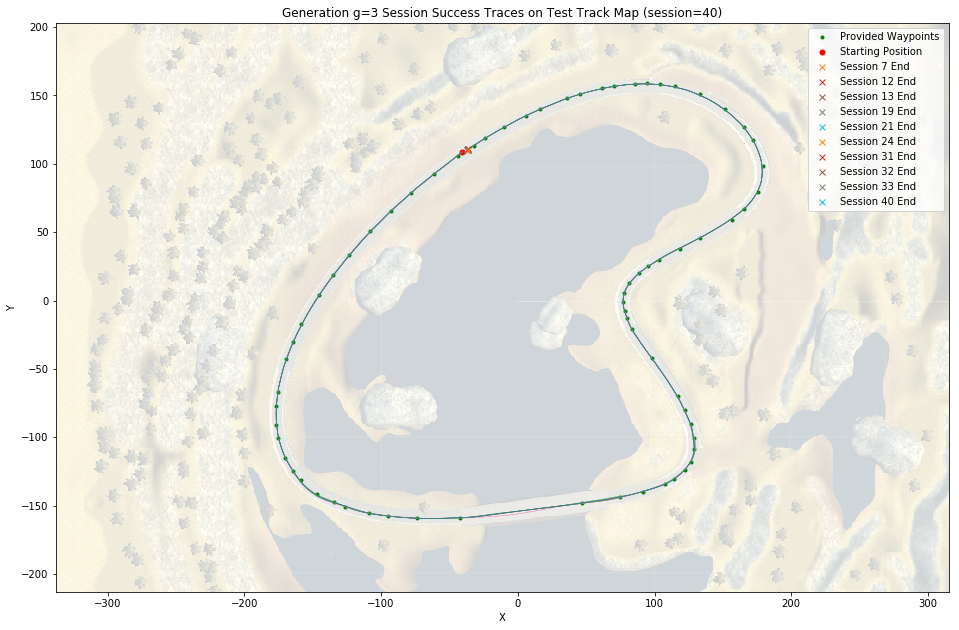

In [37]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Success Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_success['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_success[result_success['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()
all_result_success = pd.concat([all_result_success, result_success])
all_testing_sessions += testing_sessions

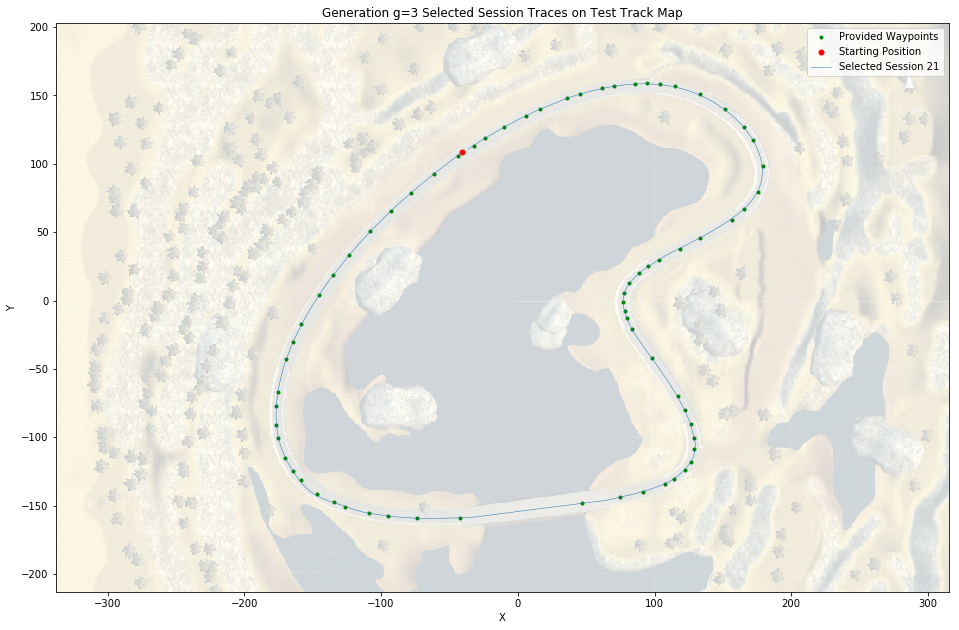

In [38]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Selected Session Traces on Test Track Map'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
j = int(selected['session'])
testing_sessions.append(testing_data[testing_data['session'] == j])
sessions.append(plt.plot(testing_sessions[0]['x'], testing_sessions[0]['y'], alpha=1.0, lw=0.5, zorder=40-i)[0])
labels.append('Selected Session {}'.format(j))
plt.legend(sessions, labels)
plt.show()

In [39]:
data = pd.read_csv('../gen4/training-progress.csv')
generation = 'g=4'

In [40]:
# create subsets
training_data = data[data['testing'] == False]
testing_data = data[data['testing'] == True]
testing_sessions = []
testing_sessions_end = []
for i in range(testing_data['session'].max()):
    testing_sessions.append(testing_data[testing_data['session'] == (i+1)])
    end_timestep = testing_sessions[i]['lap_timestep'].max()
    testing_sessions_end.append(testing_sessions[i][testing_sessions[i]['lap_timestep'] == end_timestep])
test_end = pd.concat(testing_sessions_end)
test_end

,session,testing,lap_timestep,training_sample,acte,mse,success,x,y
1290,1,True,54,250,57.716193,0.011350,False,-65.131780,92.286030
2530,2,True,466,250,297.183419,0.008250,False,-27.042630,-155.514800
3052,3,True,171,250,101.985295,0.006862,False,-147.699800,-3.332794
3977,4,True,630,250,192.202646,0.003604,False,126.050200,-121.972600
4603,5,True,165,250,66.740201,0.002547,False,-143.752700,2.783156
5273,6,True,472,224,124.263999,0.002186,False,-31.004310,-156.002900
5908,7,True,475,192,181.165637,0.002479,False,-18.291680,-154.419100
6871,8,True,632,250,218.808007,0.001749,False,127.396700,-119.979200
7531,9,True,373,250,157.605857,0.002275,False,-112.478600,-152.498500
8252,10,True,483,244,153.692133,0.001264,False,-10.749300,-153.384600


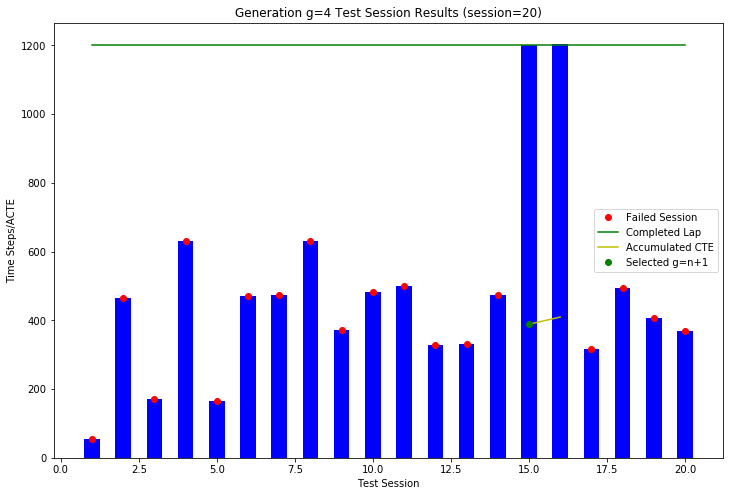

In [41]:
# create subsets
subsample = test_end[test_end['session'] < 21]
result_success = subsample[subsample['success'] == True]
result_failure = subsample[subsample['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = subsample['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, subsample['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(subsample['session'], np.ones(subsample['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=20)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

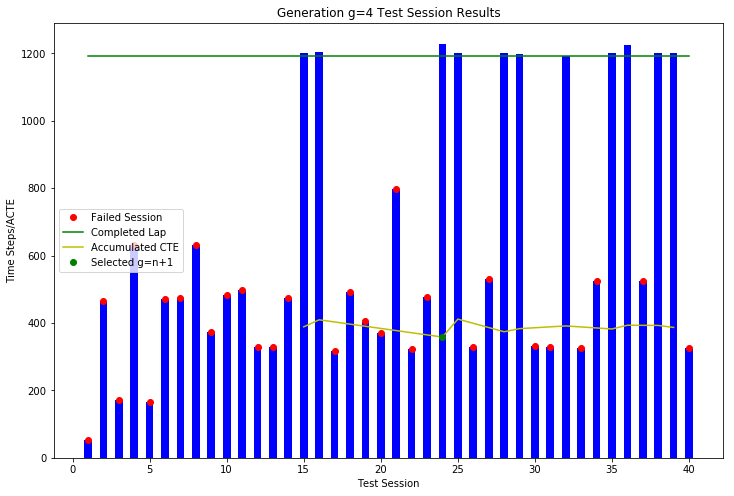

In [42]:
# create subsets
result_success = test_end[test_end['success'] == True]
result_failure = test_end[test_end['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = test_end['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(test_end['session'], np.ones(test_end['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

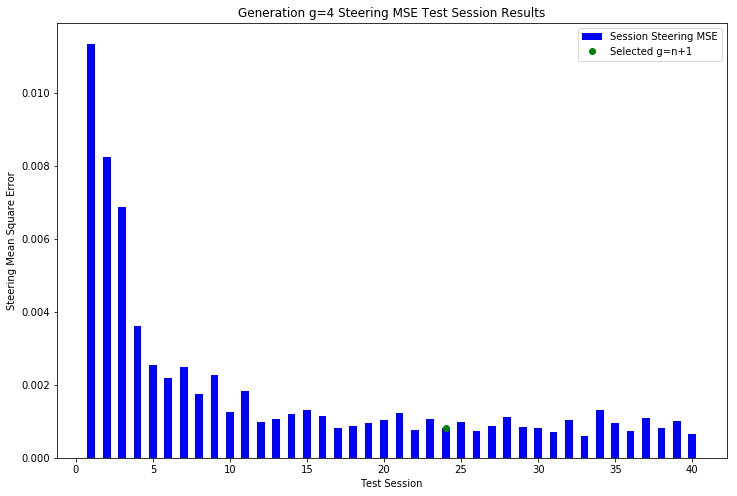

In [43]:
fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['mse'], width, color='b', label='Session Steering MSE')
p1 = ax1.plot(selected['session'], selected['mse'], 'go', label='Selected g=n+1')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Steering Mean Square Error", fontsize=10)
plt.title('Generation {} Steering MSE Test Session Results'.format(generation))
plt.legend((p0[0], p1[0]), ('Session Steering MSE', 'Selected g=n+1'))
plt.show()

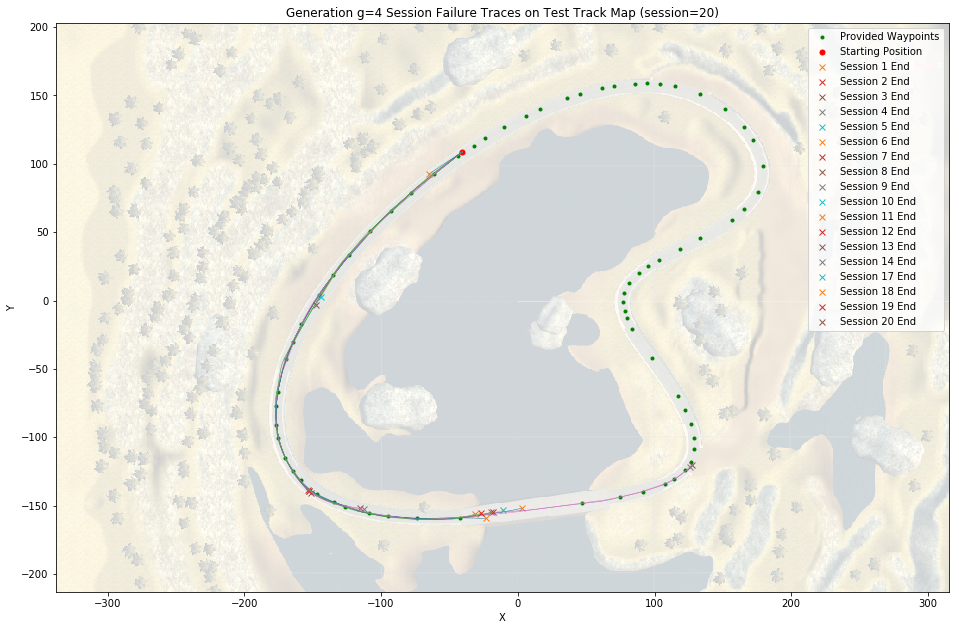

In [44]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=20)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    if j < 21:
        testing_sessions.append(testing_data[testing_data['session'] == j])
        testing_sessions_end.append(result_failure[result_failure['session'] == j])
        plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
        sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
        labels.append('Session {} End'.format(j))
        i += 1
plt.legend(sessions, labels)
plt.show()

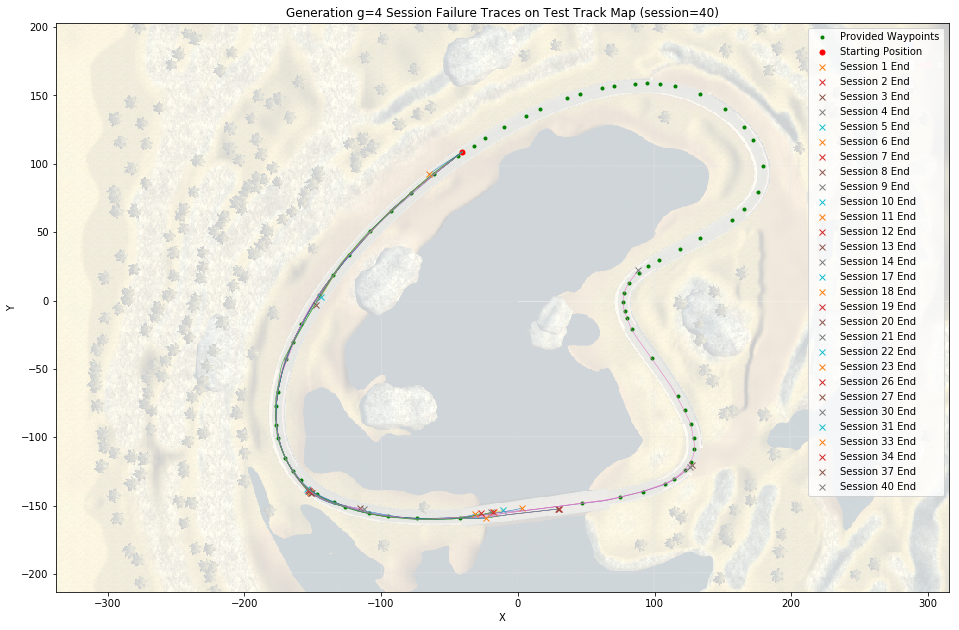

In [45]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_failure[result_failure['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()

In [46]:
result_success.describe()

,session,lap_timestep,training_sample,acte,mse,x,y
count,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000
mean,28.818182,1205.000000,108.636364,388.360365,0.000983,-36.438842,110.689200
std,8.256127,11.269428,21.195626,14.859740,0.000172,0.267433,0.172863
min,15.000000,1193.000000,63.000000,358.348487,0.000734,-37.065050,110.260800
25%,24.500000,1200.000000,100.000000,382.769971,0.000839,-36.570210,110.636650
50%,29.000000,1201.000000,108.000000,388.618988,0.000978,-36.410950,110.676900
75%,35.500000,1203.000000,117.500000,393.100141,0.001084,-36.260955,110.801600
max,39.000000,1229.000000,144.000000,411.577640,0.001321,-36.125430,110.901300


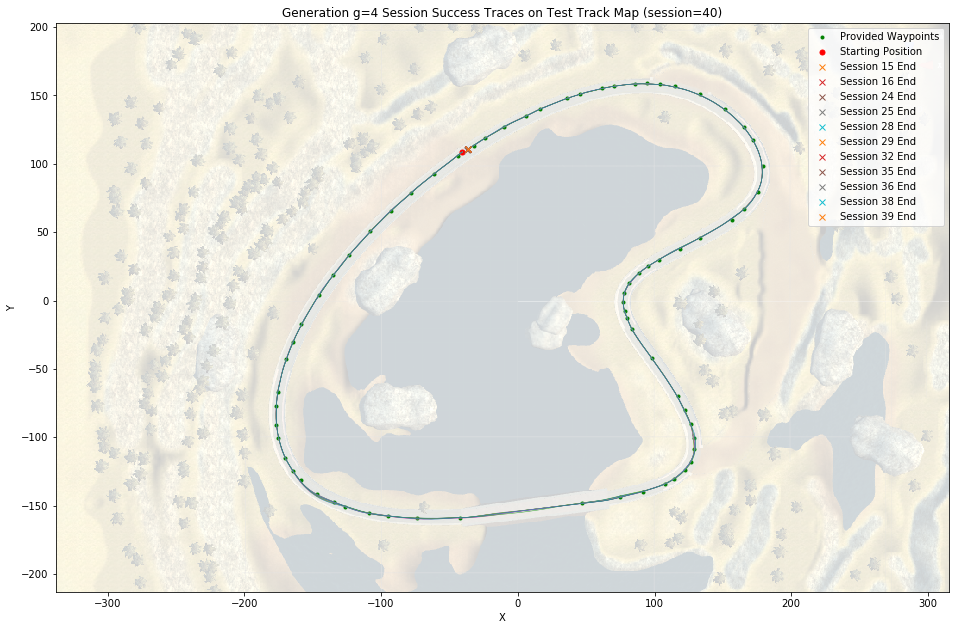

In [47]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Success Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_success['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_success[result_success['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()
all_result_success = pd.concat([all_result_success, result_success])
all_testing_sessions += testing_sessions

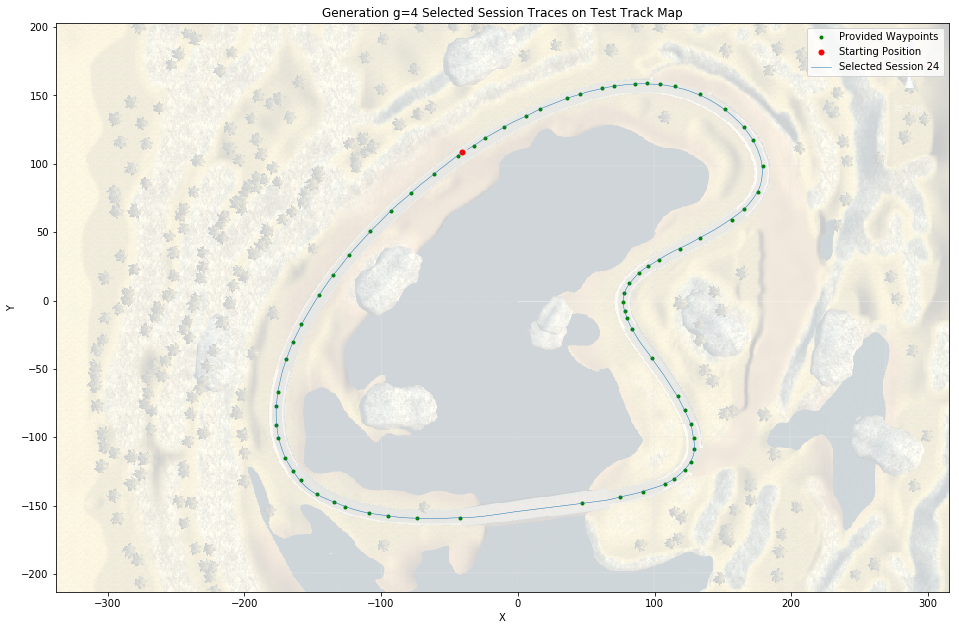

In [48]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Selected Session Traces on Test Track Map'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
j = int(selected['session'])
testing_sessions.append(testing_data[testing_data['session'] == j])
sessions.append(plt.plot(testing_sessions[0]['x'], testing_sessions[0]['y'], alpha=1.0, lw=0.5, zorder=40-i)[0])
labels.append('Selected Session {}'.format(j))
plt.legend(sessions, labels)
plt.show()

In [49]:
data = pd.read_csv('../gen5/training-progress.csv')
generation = 'g=5'

In [50]:
# create subsets
training_data = data[data['testing'] == False]
testing_data = data[data['testing'] == True]
testing_sessions = []
testing_sessions_end = []
for i in range(testing_data['session'].max()):
    testing_sessions.append(testing_data[testing_data['session'] == (i+1)])
    end_timestep = testing_sessions[i]['lap_timestep'].max()
    testing_sessions_end.append(testing_sessions[i][testing_sessions[i]['lap_timestep'] == end_timestep])
test_end = pd.concat(testing_sessions_end)
test_end

,session,testing,lap_timestep,training_sample,acte,mse,success,x,y
1522,1,True,314,250,78.416814,0.004899,False,-159.915500,-133.36330
2399,2,True,337,250,87.706614,0.002856,False,-154.039600,-138.43660
2876,3,True,332,197,85.452729,0.001903,False,-150.030500,-141.42210
3676,4,True,655,171,152.224147,0.001185,False,130.866700,-98.24877
4647,5,True,639,250,206.148445,0.001835,False,129.782600,-115.86090
5368,6,True,492,239,97.393054,0.001228,False,-3.269604,-152.58960
6675,7,True,1205,170,393.568820,0.001286,True,-36.578130,110.71350
7327,8,True,473,174,137.761577,0.001379,False,-21.026860,-159.01950
7998,9,True,471,187,105.904948,0.001302,False,-23.255470,-155.19040
8782,10,True,680,145,150.986336,0.001149,False,131.148300,-108.93140


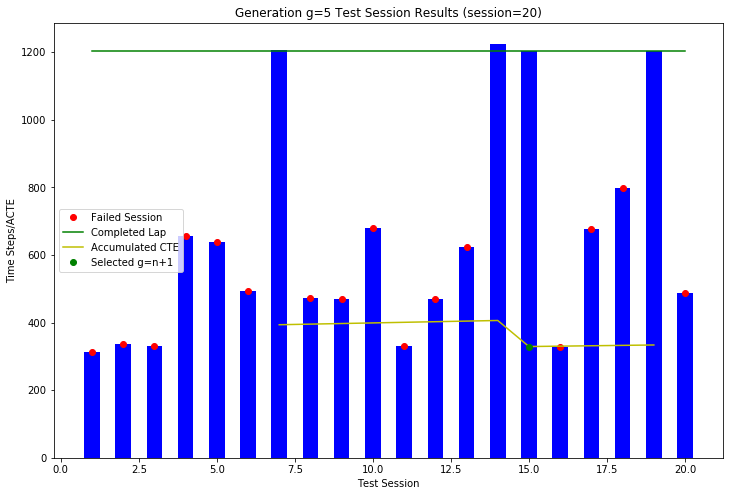

In [51]:
# create subsets
subsample = test_end[test_end['session'] < 21]
result_success = subsample[subsample['success'] == True]
result_failure = subsample[subsample['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = subsample['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, subsample['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(subsample['session'], np.ones(subsample['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results (session=20)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

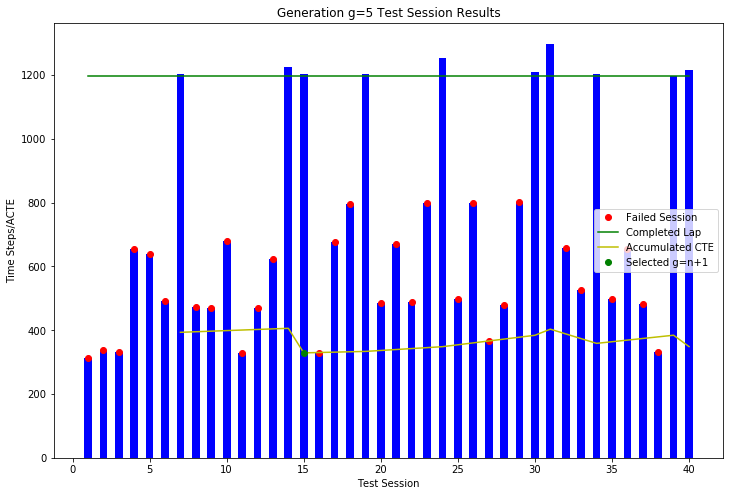

In [52]:
# create subsets
result_success = test_end[test_end['success'] == True]
result_failure = test_end[test_end['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = test_end['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(test_end['session'], np.ones(test_end['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('Generation {} Test Session Results'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

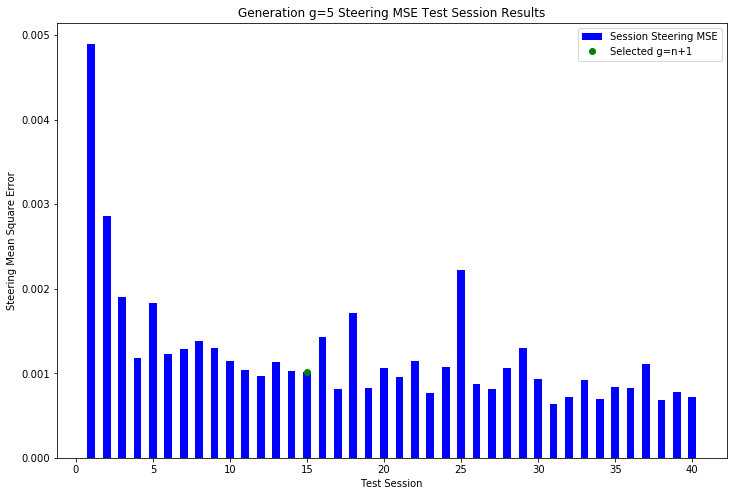

In [53]:
fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['mse'], width, color='b', label='Session Steering MSE')
p1 = ax1.plot(selected['session'], selected['mse'], 'go', label='Selected g=n+1')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Steering Mean Square Error", fontsize=10)
plt.title('Generation {} Steering MSE Test Session Results'.format(generation))
plt.legend((p0[0], p1[0]), ('Session Steering MSE', 'Selected g=n+1'))
plt.show()

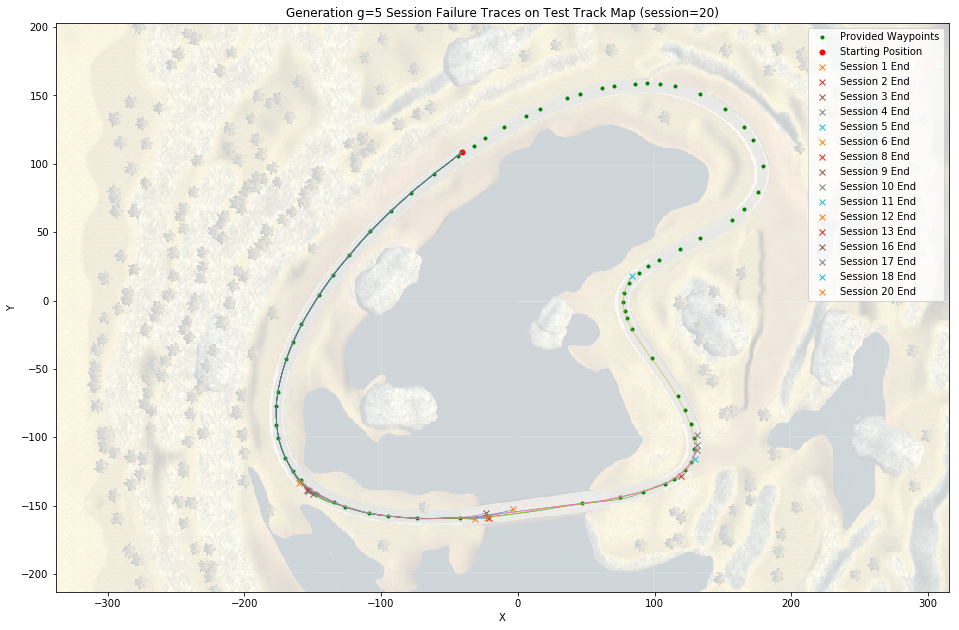

In [54]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=20)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    if j < 21:
        testing_sessions.append(testing_data[testing_data['session'] == j])
        testing_sessions_end.append(result_failure[result_failure['session'] == j])
        plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
        sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
        labels.append('Session {} End'.format(j))
        i += 1
plt.legend(sessions, labels)
plt.show()

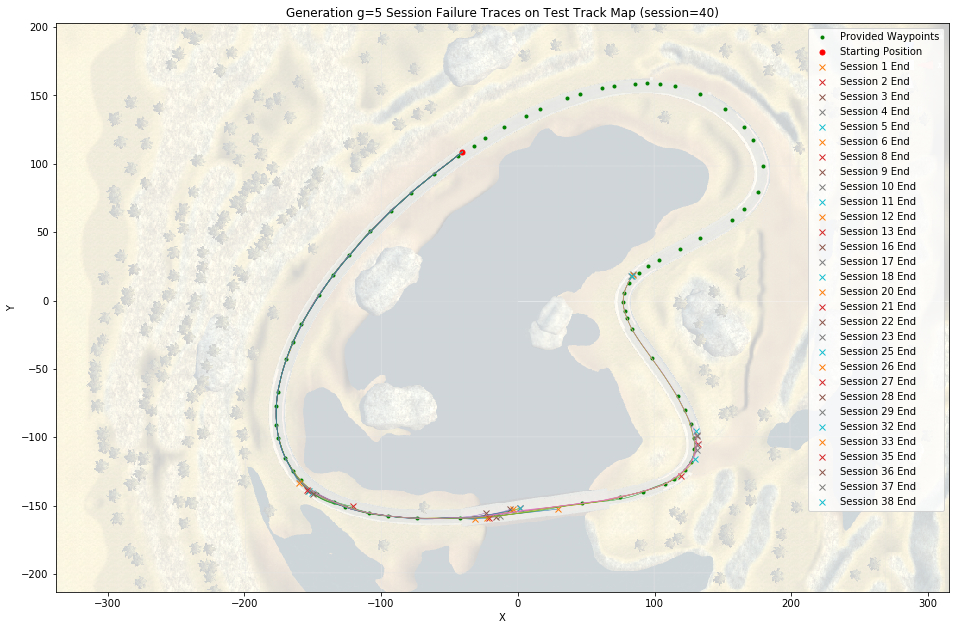

In [55]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Failure Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_failure[result_failure['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()

In [56]:
result_success.describe()

,session,lap_timestep,training_sample,acte,mse,x,y
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,25.300000,1221.600000,112.000000,369.074642,0.000899,-36.468670,110.708120
std,11.274849,31.605907,38.175035,28.703052,0.000203,0.256916,0.136670
min,7.000000,1197.000000,57.000000,329.065217,0.000642,-37.015000,110.472300
25%,16.000000,1204.250000,93.250000,348.556101,0.000736,-36.605738,110.637825
50%,27.000000,1207.000000,112.500000,371.582608,0.000876,-36.408365,110.745050
75%,33.250000,1222.750000,130.500000,391.285804,0.001027,-36.303675,110.803950
max,40.000000,1299.000000,170.000000,406.127833,0.001286,-36.114490,110.867100


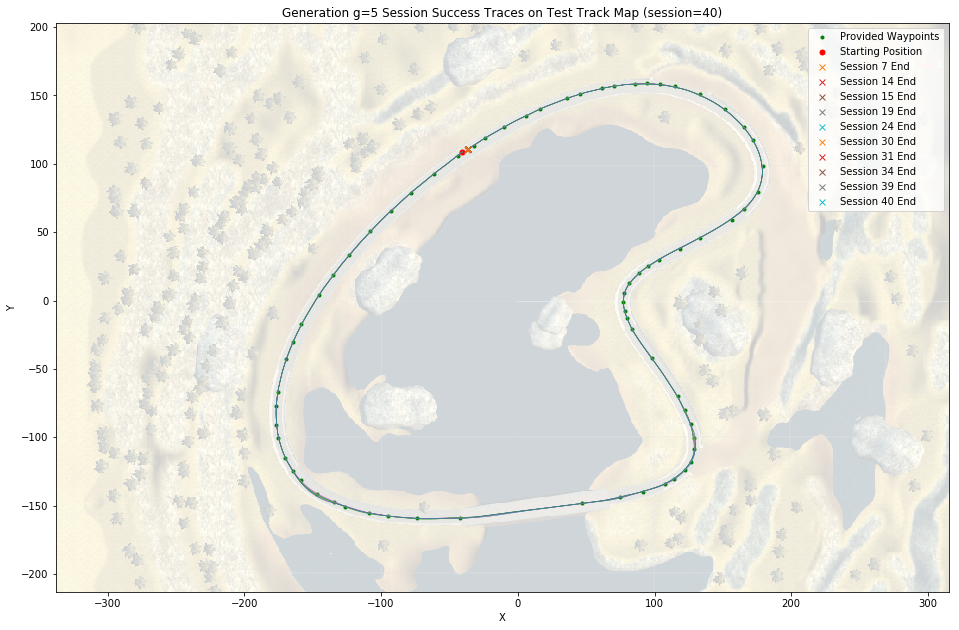

In [57]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Success Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_success['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_success[result_success['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()
all_result_success = pd.concat([all_result_success, result_success])
all_testing_sessions += testing_sessions

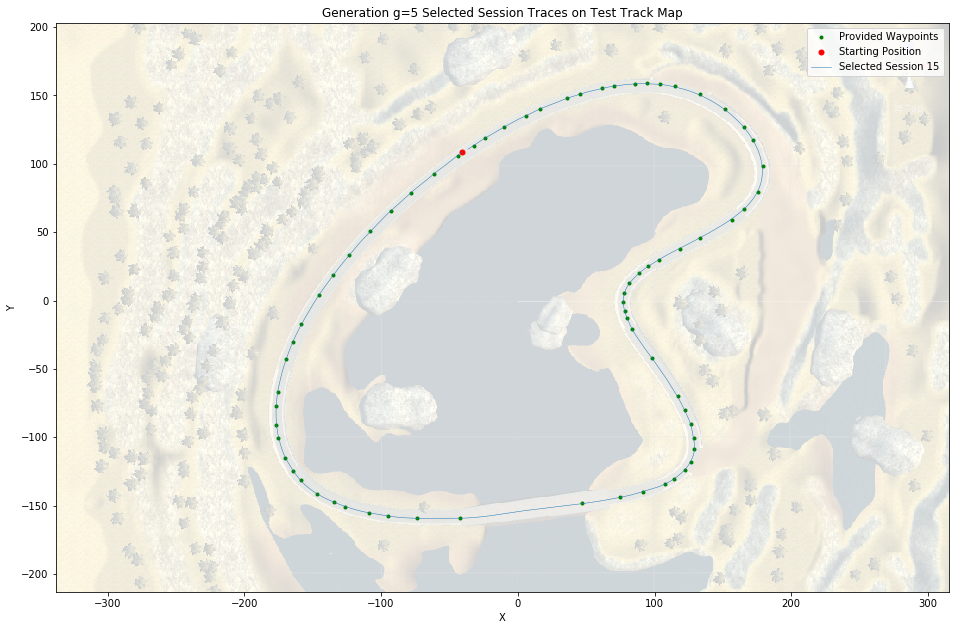

In [58]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Selected Session Traces on Test Track Map'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
j = int(selected['session'])
testing_sessions.append(testing_data[testing_data['session'] == j])
sessions.append(plt.plot(testing_sessions[0]['x'], testing_sessions[0]['y'], alpha=1.0, lw=0.5, zorder=40-i)[0])
labels.append('Selected Session {}'.format(j))
plt.legend(sessions, labels)
plt.show()

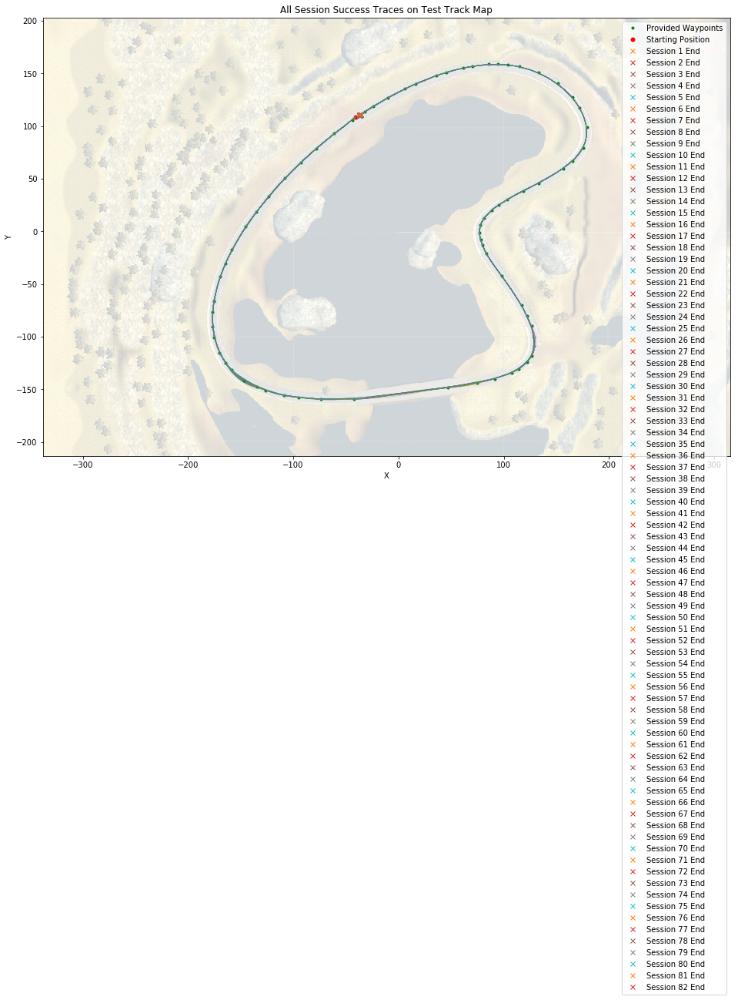

In [59]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('All Session Success Traces on Test Track Map')
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in all_result_success['session']:
    testing_sessions_end.append(all_result_success[all_result_success['session'] == j])
    if i < len(all_testing_sessions):
        plt.plot(all_testing_sessions[i]['x'], all_testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(i+1))
    i += 1
plt.legend(sessions, labels)
plt.show()

In [60]:
data = pd.read_csv('../speed/training-progress.csv')
generation = 'Speed training'

In [61]:
# create subsets
training_data = data[data['testing'] == False]
testing_data = data[data['testing'] == True]
testing_sessions = []
testing_sessions_end = []
for i in range(testing_data['session'].max()):
    testing_sessions.append(testing_data[testing_data['session'] == (i+1)])
    end_timestep = testing_sessions[i]['lap_timestep'].max()
    testing_sessions_end.append(testing_sessions[i][testing_sessions[i]['lap_timestep'] == end_timestep])
test_end = pd.concat(testing_sessions_end)
test_end

,session,testing,lap_timestep,training_sample,acte,mse,success,x,y
646,1,True,109,250,57.185970,0.005169,False,-114.74700,46.15746
1561,2,True,453,250,228.313626,0.009546,False,49.35419,-149.84310
2353,3,True,532,250,192.723869,0.002856,False,129.93360,-114.89120
3087,4,True,534,225,216.731101,0.002002,False,131.04810,-110.55140
4409,5,True,1009,250,430.460309,0.001886,True,-36.35717,110.97410
4838,6,True,280,199,115.253386,0.001903,False,-138.75750,-143.33780
5630,7,True,665,163,371.607641,0.003380,False,79.36960,13.33038
6891,8,True,996,214,382.765648,0.001354,True,-36.60373,110.43540
7995,9,True,996,161,429.900129,0.001461,True,-36.48901,110.77470
8655,10,True,551,135,227.817246,0.001660,False,122.89460,-85.42284


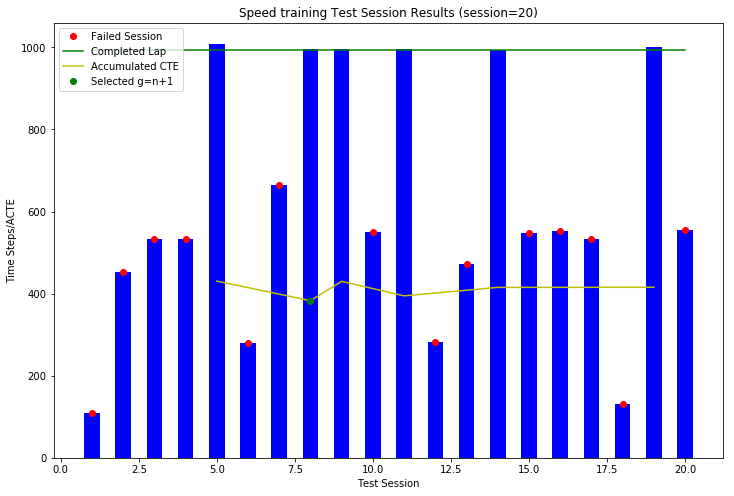

In [62]:
# create subsets
subsample = test_end[test_end['session'] < 21]
result_success = subsample[subsample['success'] == True]
result_failure = subsample[subsample['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = subsample['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, subsample['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(subsample['session'], np.ones(subsample['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('{} Test Session Results (session=20)'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

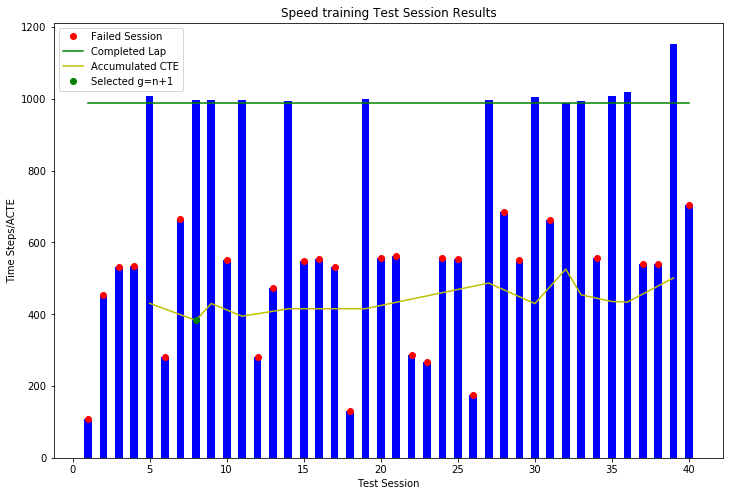

In [63]:
# create subsets
result_success = test_end[test_end['success'] == True]
result_failure = test_end[test_end['success'] == False]
laptimestep = result_success['lap_timestep'].min()
minacte = result_success['acte'].min()
selected = result_success[result_success['acte'] == minacte]

N = test_end['session'].max()
ind = np.arange(N)  # the x locations for the groups
width = 0.5           # the width of the bars

fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['lap_timestep'], width, color='b')
p1 = ax1.plot(result_failure['session'], result_failure['lap_timestep'], 'ro')
p2 = ax1.plot(test_end['session'], np.ones(test_end['session'].count())*laptimestep, 'g')
p3 = ax1.plot(result_success['session'], result_success['acte'], 'y')
p4 = ax1.plot(selected['session'], selected['acte'], 'go')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Time Steps/ACTE", fontsize=10)
plt.title('{} Test Session Results'.format(generation))
plt.legend((p1[0], p2[0], p3[0], p4[0]), ('Failed Session', 'Completed Lap', 'Accumulated CTE', 'Selected g=n+1'))
plt.show()

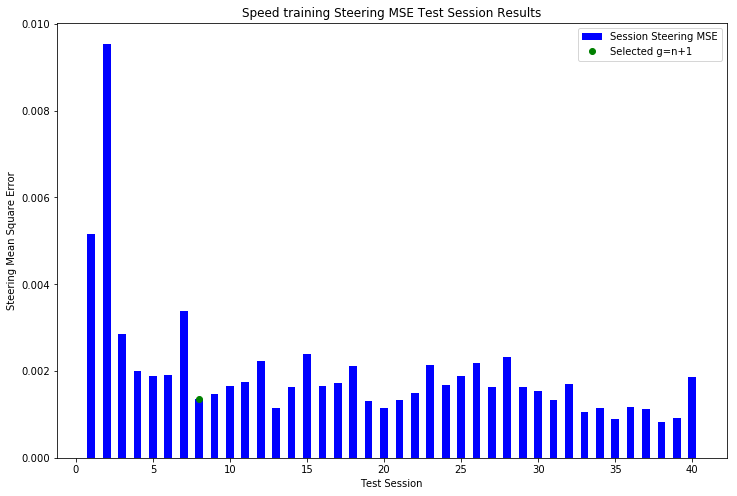

In [64]:
fig, (ax1) = plt.subplots(1, 1, figsize=(12, 8))
p0 = ax1.bar(ind+1, test_end['mse'], width, color='b', label='Session Steering MSE')
p1 = ax1.plot(selected['session'], selected['mse'], 'go', label='Selected g=n+1')
ax1.set_xlabel("Test Session", fontsize=10)
ax1.set_ylabel("Steering Mean Square Error", fontsize=10)
plt.title('{} Steering MSE Test Session Results'.format(generation))
plt.legend((p0[0], p1[0]), ('Session Steering MSE', 'Selected g=n+1'))
plt.show()

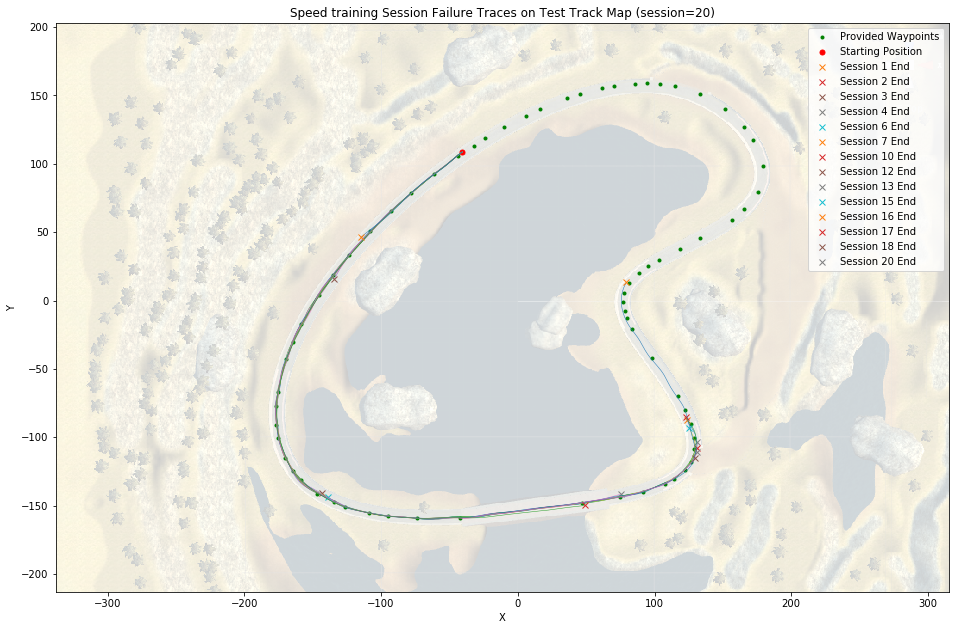

In [65]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('{} Session Failure Traces on Test Track Map (session=20)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    if j < 21:
        testing_sessions.append(testing_data[testing_data['session'] == j])
        testing_sessions_end.append(result_failure[result_failure['session'] == j])
        plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
        sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
        labels.append('Session {} End'.format(j))
        i += 1
plt.legend(sessions, labels)
plt.show()

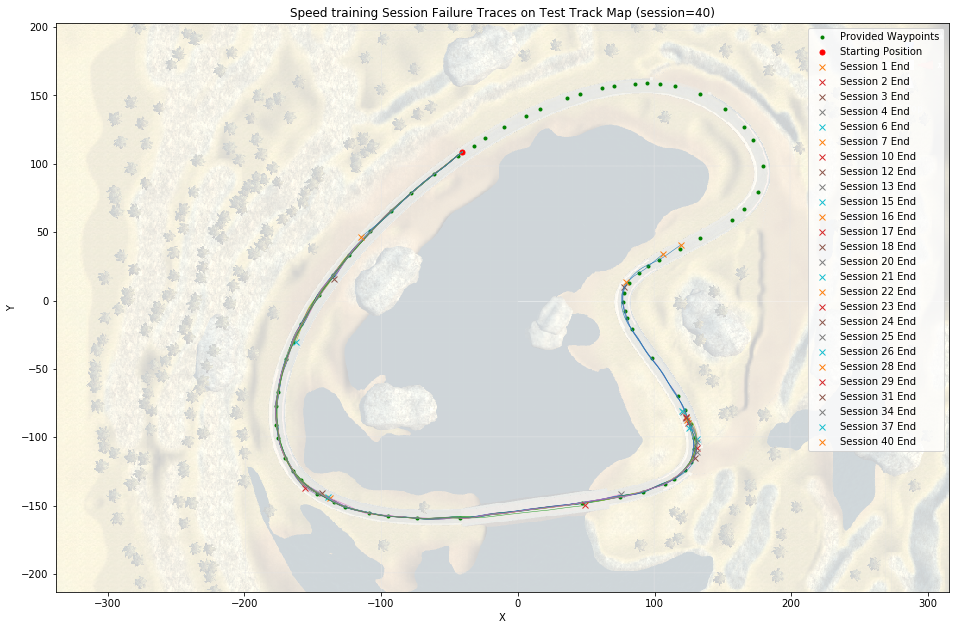

In [66]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('{} Session Failure Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_failure['session']:
    # corrupted session 38 - skip
    if j != 38:
        testing_sessions.append(testing_data[testing_data['session'] == j])
        testing_sessions_end.append(result_failure[result_failure['session'] == j])
        plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
        sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
        labels.append('Session {} End'.format(j))
        i += 1
plt.legend(sessions, labels)
plt.show()

In [67]:
result_success.describe()

,session,lap_timestep,training_sample,acte,mse,x,y
count,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000
mean,22.923077,1012.000000,146.692308,441.140737,0.001408,-36.362746,110.544300
std,12.250589,43.435776,51.470679,41.222862,0.000326,0.274601,0.223225
min,5.000000,989.000000,95.000000,382.765648,0.000888,-36.929300,110.267400
25%,11.000000,996.000000,105.000000,415.462031,0.001166,-36.489010,110.357200
50%,27.000000,997.000000,118.000000,430.460309,0.001461,-36.357170,110.512000
75%,33.000000,1007.000000,177.000000,453.991667,0.001634,-36.209950,110.679100
max,39.000000,1154.000000,250.000000,525.649096,0.001886,-35.945740,110.974100


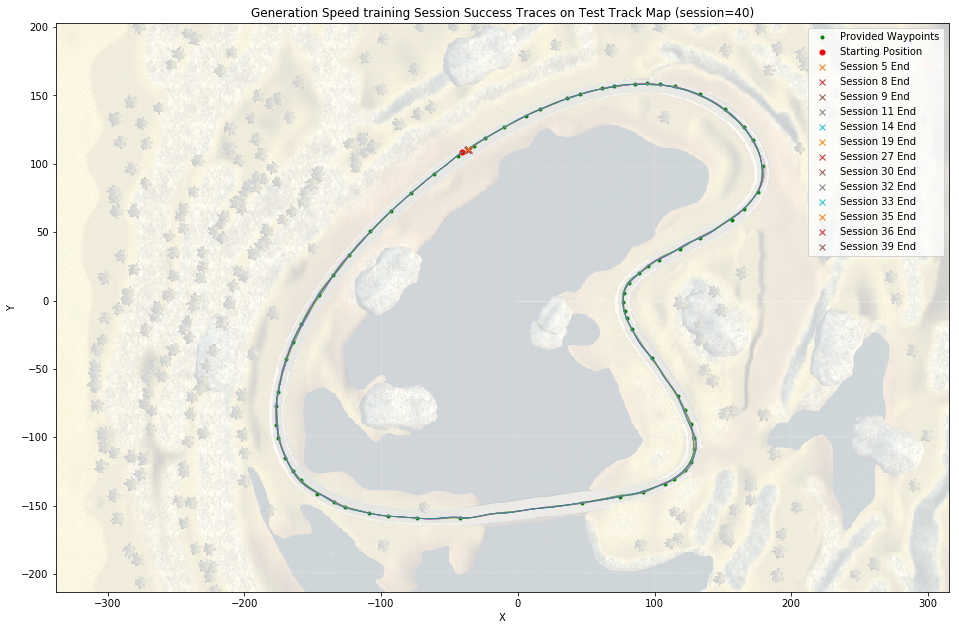

In [68]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('Generation {} Session Success Traces on Test Track Map (session=40)'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
i = 0
for j in result_success['session']:
    testing_sessions.append(testing_data[testing_data['session'] == j])
    testing_sessions_end.append(result_success[result_success['session'] == j])
    plt.plot(testing_sessions[i]['x'], testing_sessions[i]['y'], alpha=1.0, lw=0.5, zorder=40-i)
    sessions.append(plt.plot(testing_sessions_end[i]['x'], testing_sessions_end[i]['y'], 'x', alpha=1.0, lw=0.5, zorder=40-i)[0])
    labels.append('Session {} End'.format(j))
    i += 1
plt.legend(sessions, labels)
plt.show()
all_result_success = pd.concat([all_result_success, result_success])

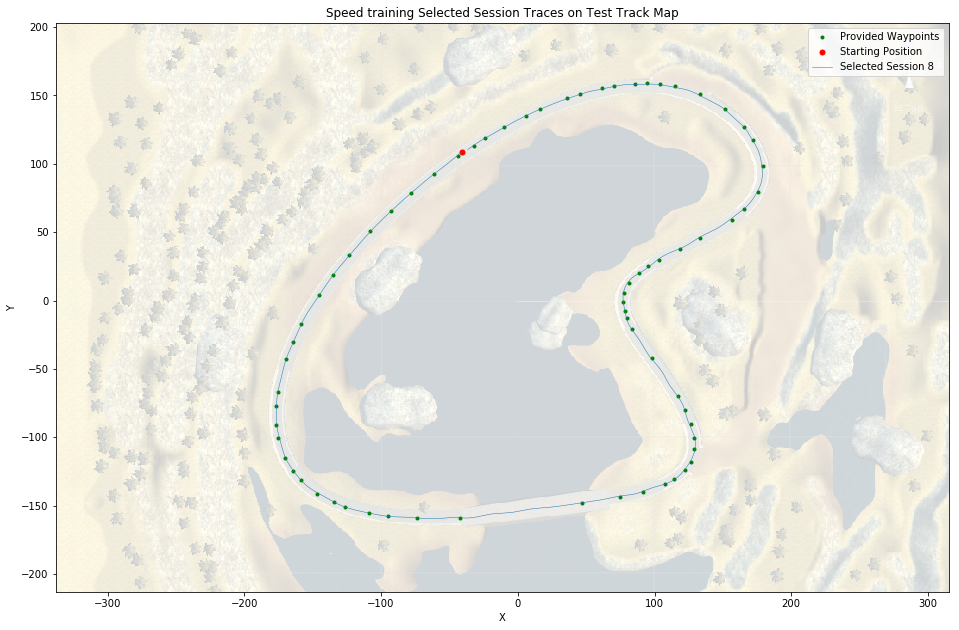

In [69]:
p0 = plt.imshow(img, extent=(-338, 315, -213, 203), alpha=0.2)
p1 = plt.plot(x_waypoint, y_waypoint, 'go', ms=3.0)
p2 = plt.plot(x_start, y_start, 'ro', ms=5.0)
testing_sessions = []
testing_sessions_end = []
sessions = [p1[0], p2[0]]
labels = ['Provided Waypoints', 'Starting Position']
plt.title('{} Selected Session Traces on Test Track Map'.format(generation))
plt.xlabel('X')
plt.ylabel('Y')
j = int(selected['session'])
testing_sessions.append(testing_data[testing_data['session'] == j])
sessions.append(plt.plot(testing_sessions[0]['x'], testing_sessions[0]['y'], alpha=1.0, lw=0.5, zorder=40-i)[0])
labels.append('Selected Session {}'.format(j))
plt.legend(sessions, labels)
plt.show()